# A model to detect cheaters in CSGO dataset

## Dataset info:

#### SOURCE: https://www.kaggle.com/datasets/emstatsl/csgo-cheating-dataset?resource=download

10 000 clean players and 2 000 cheaters.  
Data is stored as numpy arrays.  
Data is in shape (players, 30, 192, 5).  

30 = number of engagements per player (always 30)  
192 = timesteps, ticks around the engagement (5 seconds before, 1 second after)  
5 = input variables: AttackerDeltaYaw, AttackerDeltaPitch, CrosshairToVictimYaw, CrosshairToVictimPitch, Firing  

Firing is 1 or 0 and the rest are normal floats (all the data is stored in float32 numpy arrays).

## Reading in files and combining both cheaters and non-cheaters into one dataset

In [1]:
import numpy as np

In [2]:
cheaters_arr = np.load("csgo_dataset/cheaters/cheaters.npy")

In [3]:
cheaters_arr.shape

(2000, 30, 192, 5)

In [5]:
num_players = cheaters_arr.shape[0]
num_engagements = cheaters_arr.shape[1]
num_timesteps = cheaters_arr.shape[2]

In [ ]:
# Write cheaters' data to pandas dataframe

player_id_arr = []
engagement_id_arr = []
timestep_id_arr = []
attacker_delta_yaw_arr = []
attacker_delta_pitch_arr = []
crosshair_to_victim_yaw_arr = []
crosshair_to_victim_pitch_arr = []
firing_arr = []
for player in range(num_players):
    for engagement in range(num_engagements):
        for timestep in range(num_timesteps):
            attacker_delta_yaw_arr.append(cheaters_arr[player][engagement][timestep][0])
            attacker_delta_pitch_arr.append(cheaters_arr[player][engagement][timestep][1])
            crosshair_to_victim_yaw_arr.append(cheaters_arr[player][engagement][timestep][2])
            crosshair_to_victim_pitch_arr.append(cheaters_arr[player][engagement][timestep][3])
            firing_arr.append(cheaters_arr[player][engagement][timestep][4])
            timestep_id_arr.append(timestep)
            engagement_id_arr.append(engagement)
            player_id_arr.append(player)

df_cheaters = pd.DataFrame({"player_id":player_id_arr, "engagement_id":engagement_id_arr, "timestep_id":timestep_id_arr,\
                 "attacker_delta_yaw":attacker_delta_yaw_arr, "attacker_delta_pitch":attacker_delta_pitch_arr,\
                  "crosshair_tovictim_yaw":crosshair_to_victim_yaw_arr, \
                    "crosshair_tovictim_pitch":crosshair_to_victim_pitch_arr, "firing":firing_arr})

In [28]:
df_cheaters["cheater"] = np.ones(len(df_cheaters)).astype(int)

In [29]:
df_cheaters

,player_id,engagement_id,timestep_id,attacker_delta_yaw,attacker_delta_pitch,crosshair_tovictim_yaw,crosshair_tovictim_pitch,firing,cheater
0,0,0,0,0.000,0.000,11.744,-0.741,0.0,1
1,0,0,1,0.000,0.000,11.548,-0.741,0.0,1
2,0,0,2,0.000,0.000,11.315,-0.741,0.0,1
3,0,0,3,0.000,0.000,11.136,-0.741,0.0,1
4,0,0,4,0.000,0.000,10.995,-0.741,0.0,1
...,...,...,...,...,...,...,...,...,...
11519995,1999,29,187,0.247,-0.049,-2.104,-10.250,0.0,1
11519996,1999,29,188,0.192,-0.049,-2.118,-10.201,0.0,1
11519997,1999,29,189,0.291,0.000,-2.227,-10.196,1.0,1
11519998,1999,29,190,0.291,0.000,-2.371,-10.187,0.0,1


In [4]:
noncheaters_arr = np.load("csgo_dataset/legit/legit.npy")

In [12]:
noncheaters_arr.shape

(10000, 30, 192, 5)

In [14]:
num_players = noncheaters_arr.shape[0]
num_engagements = noncheaters_arr.shape[1]
num_timesteps = noncheaters_arr.shape[2]

In [16]:
# Write legitimate players' data to pandas dataframe

player_id_arr = []
engagement_id_arr = []
timestep_id_arr = []
attacker_delta_yaw_arr = []
attacker_delta_pitch_arr = []
crosshair_to_victim_yaw_arr = []
crosshair_to_victim_pitch_arr = []
firing_arr = []
for player in range(num_players):
    for engagement in range(num_engagements):
        for timestep in range(num_timesteps):
            attacker_delta_yaw_arr.append(noncheaters_arr[player][engagement][timestep][0])
            attacker_delta_pitch_arr.append(noncheaters_arr[player][engagement][timestep][1])
            crosshair_to_victim_yaw_arr.append(noncheaters_arr[player][engagement][timestep][2])
            crosshair_to_victim_pitch_arr.append(noncheaters_arr[player][engagement][timestep][3])
            firing_arr.append(noncheaters_arr[player][engagement][timestep][4])
            timestep_id_arr.append(timestep)
            engagement_id_arr.append(engagement)
            player_id_arr.append(2000+player)

df_legit = pd.DataFrame({"player_id":player_id_arr, "engagement_id":engagement_id_arr, "timestep_id":timestep_id_arr,\
                 "attacker_delta_yaw":attacker_delta_yaw_arr, "attacker_delta_pitch":attacker_delta_pitch_arr,\
                  "crosshair_tovictim_yaw":crosshair_to_victim_yaw_arr, \
                    "crosshair_tovictim_pitch":crosshair_to_victim_pitch_arr, "firing":firing_arr})

In [31]:
df_legit["cheater"] = np.zeros(len(df_legit)).astype(int)

In [32]:
df_legit

,player_id,engagement_id,timestep_id,attacker_delta_yaw,attacker_delta_pitch,crosshair_tovictim_yaw,crosshair_tovictim_pitch,firing,cheater
0,2000,0,0,0.011,0.000,-21.562000,-80.019997,0.0,0
1,2000,0,1,0.016,-0.016,-21.646999,-80.148003,0.0,0
2,2000,0,2,0.000,0.000,-21.759001,-80.290001,0.0,0
3,2000,0,3,-0.016,0.000,-21.979000,-80.421997,0.0,0
4,2000,0,4,-0.077,-0.011,-22.219000,-80.538002,0.0,0
...,...,...,...,...,...,...,...,...,...
57599995,11999,29,187,-0.758,0.049,9.195000,-1.017000,0.0,0
57599996,11999,29,188,-0.253,0.000,9.211000,-1.013000,0.0,0
57599997,11999,29,189,0.000,0.000,9.115000,-1.019000,0.0,0
57599998,11999,29,190,0.505,0.000,8.535000,-1.022000,0.0,0


In [34]:
df_final = df_cheaters.append(df_legit, ignore_index=True)

In [38]:
df_final = df_final.astype({"firing":"int"})

In [39]:
df_final

,player_id,engagement_id,timestep_id,attacker_delta_yaw,attacker_delta_pitch,crosshair_tovictim_yaw,crosshair_tovictim_pitch,firing,cheater
0,0,0,0,0.000,0.000,11.744,-0.741,0,1
1,0,0,1,0.000,0.000,11.548,-0.741,0,1
2,0,0,2,0.000,0.000,11.315,-0.741,0,1
3,0,0,3,0.000,0.000,11.136,-0.741,0,1
4,0,0,4,0.000,0.000,10.995,-0.741,0,1
...,...,...,...,...,...,...,...,...,...
69119995,11999,29,187,-0.758,0.049,9.195,-1.017,0,0
69119996,11999,29,188,-0.253,0.000,9.211,-1.013,0,0
69119997,11999,29,189,0.000,0.000,9.115,-1.019,0,0
69119998,11999,29,190,0.505,0.000,8.535,-1.022,0,0


In [40]:
df_final.to_csv("csgo_dataset.csv")

# EDA

In [1]:
import numpy as np
import pandas as pd
import scipy as sp
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
dataset = pd.read_csv("csgo_dataset.csv", index_col="Unnamed: 0")

In [10]:
dataset

,player_id,engagement_id,timestep_id,attacker_delta_yaw,attacker_delta_pitch,crosshair_tovictim_yaw,crosshair_tovictim_pitch,firing,cheater
0,0,0,0,0.000,0.000,11.744,-0.741,0,1
1,0,0,1,0.000,0.000,11.548,-0.741,0,1
2,0,0,2,0.000,0.000,11.315,-0.741,0,1
3,0,0,3,0.000,0.000,11.136,-0.741,0,1
4,0,0,4,0.000,0.000,10.995,-0.741,0,1
...,...,...,...,...,...,...,...,...,...
69119995,11999,29,187,-0.758,0.049,9.195,-1.017,0,0
69119996,11999,29,188,-0.253,0.000,9.211,-1.013,0,0
69119997,11999,29,189,0.000,0.000,9.115,-1.019,0,0
69119998,11999,29,190,0.505,0.000,8.535,-1.022,0,0


### First aggregation across timesteps

In [3]:
agg_funcs = {"attacker_delta_yaw":["median", "std"], "attacker_delta_pitch":["median", "std"],
            "crosshair_tovictim_yaw": ["median", "std"], "crosshair_tovictim_pitch":["median", "std"],
            "firing": lambda x: int(x.any()), "cheater": lambda x: x.mode().iloc[0]}

In [4]:
df_engagement = dataset.groupby(["player_id", "engagement_id"]).agg(agg_funcs).reset_index()

In [13]:
df_engagement

player_id engagement_id attacker_delta_yaw            \
                                           median       std   
0              0             0             0.0000  0.812105   
1              0             1             0.0550  4.517526   
2              0             2             0.0000  2.475721   
3              0             3             0.0000  2.473708   
4              0             4             0.0000  2.473126   
...          ...           ...                ...       ...   
359995     11999            25             0.0465  2.742015   
359996     11999            26             0.0795  2.481271   
359997     11999            27             0.0000  0.625427   
359998     11999            28             0.0000  2.254171   
359999     11999            29             0.0000  0.458912   

       attacker_delta_pitch           crosshair_tovictim_yaw             \
                     median       std                 median        std   
0                       0.0  0.151031                -0.5285   7.398991   
1                       0.0  0.257290                42.1180  80.525043   
2                       0.0  0.670827                10.8805  19.078562   
3                       0.0  0.669578                10.4560  19.769224   
4                       0.0  0.671687                 9.5950  20.393926   
...                     ...       ...                    ...        ...   
359995                  0.0  0.419882                -4.6230  23.834550   
359996                  0.0  0.573610                 9.2225  49.997003   
359997                  0.0  0.281089                43.6825  21.929363   
359998                  0.0  0.568163               -10.8195  22.199412   
359999                  0.0  0.126985                 5.7790   3.190863   

       crosshair_tovictim_pitch              firing  cheater  
                         median        std <lambda> <lambda>  
0                       -1.0170   1.384020        1        1  
1                       -6.5300   3.922818        1        1  
2                      -14.6965  12.170717        1        1  
3                      -14.6965  12.180565        1        1  
4                      -14.3605  12.188346        1        1  
...                         ...        ...      ...      ...  
359995                  -0.4460   3.985048        1        0  
359996                 -11.8875   7.563940        1        0  
359997                  -4.2470   2.148456        1        0  
359998                  -4.1395   4.502174        1        0  
359999                  -0.5955   1.296356        1        0  

[360000 rows x 12 columns]

In [5]:
df_engagement.columns = ['_'.join(col).strip() for col in df_engagement.columns.values]

In [15]:
df_engagement

,player_id_,engagement_id_,attacker_delta_yaw_median,attacker_delta_yaw_std,attacker_delta_pitch_median,attacker_delta_pitch_std,crosshair_tovictim_yaw_median,crosshair_tovictim_yaw_std,crosshair_tovictim_pitch_median,crosshair_tovictim_pitch_std,firing_<lambda>,cheater_<lambda>
0,0,0,0.0000,0.812105,0.0,0.151031,-0.5285,7.398991,-1.0170,1.384020,1,1
1,0,1,0.0550,4.517526,0.0,0.257290,42.1180,80.525043,-6.5300,3.922818,1,1
2,0,2,0.0000,2.475721,0.0,0.670827,10.8805,19.078562,-14.6965,12.170717,1,1
3,0,3,0.0000,2.473708,0.0,0.669578,10.4560,19.769224,-14.6965,12.180565,1,1
4,0,4,0.0000,2.473126,0.0,0.671687,9.5950,20.393926,-14.3605,12.188346,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...
359995,11999,25,0.0465,2.742015,0.0,0.419882,-4.6230,23.834550,-0.4460,3.985048,1,0
359996,11999,26,0.0795,2.481271,0.0,0.573610,9.2225,49.997003,-11.8875,7.563940,1,0
359997,11999,27,0.0000,0.625427,0.0,0.281089,43.6825,21.929363,-4.2470,2.148456,1,0
359998,11999,28,0.0000,2.254171,0.0,0.568163,-10.8195,22.199412,-4.1395,4.502174,1,0


In [6]:
df_engagement.rename(columns={"player_id_": "player_id", "engagement_id_":"engagement_id","firing_<lambda>":"firing",
                       "cheater_<lambda>": "cheater"}, inplace=True)

In [17]:
df_engagement

,player_id,engagement_id,attacker_delta_yaw_median,attacker_delta_yaw_std,attacker_delta_pitch_median,attacker_delta_pitch_std,crosshair_tovictim_yaw_median,crosshair_tovictim_yaw_std,crosshair_tovictim_pitch_median,crosshair_tovictim_pitch_std,firing,cheater
0,0,0,0.0000,0.812105,0.0,0.151031,-0.5285,7.398991,-1.0170,1.384020,1,1
1,0,1,0.0550,4.517526,0.0,0.257290,42.1180,80.525043,-6.5300,3.922818,1,1
2,0,2,0.0000,2.475721,0.0,0.670827,10.8805,19.078562,-14.6965,12.170717,1,1
3,0,3,0.0000,2.473708,0.0,0.669578,10.4560,19.769224,-14.6965,12.180565,1,1
4,0,4,0.0000,2.473126,0.0,0.671687,9.5950,20.393926,-14.3605,12.188346,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...
359995,11999,25,0.0465,2.742015,0.0,0.419882,-4.6230,23.834550,-0.4460,3.985048,1,0
359996,11999,26,0.0795,2.481271,0.0,0.573610,9.2225,49.997003,-11.8875,7.563940,1,0
359997,11999,27,0.0000,0.625427,0.0,0.281089,43.6825,21.929363,-4.2470,2.148456,1,0
359998,11999,28,0.0000,2.254171,0.0,0.568163,-10.8195,22.199412,-4.1395,4.502174,1,0


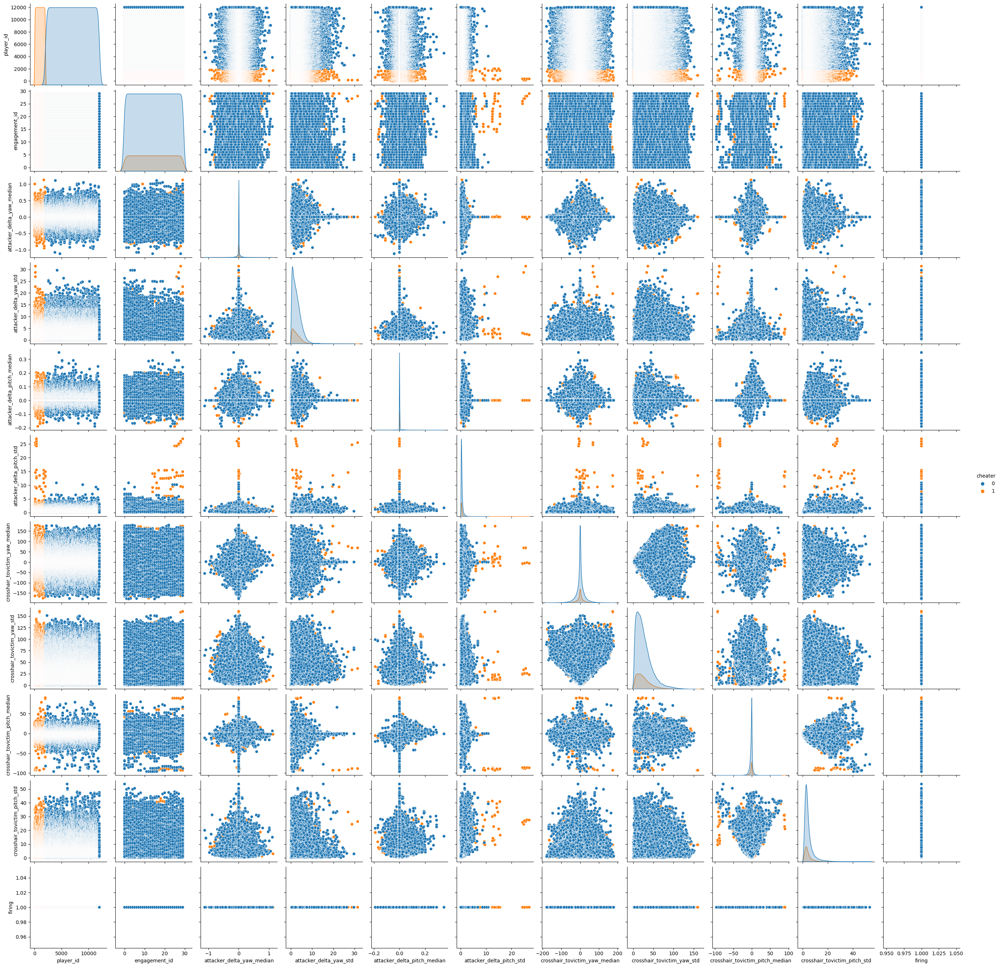

In [67]:
sns.pairplot(df_engagement, hue="cheater")

In [7]:
cols_to_plot = df_engagement.loc[:,~df_engagement.columns.isin(["player_id", "engagement_id","firing", "cheater"])].columns
cols_to_plot

Index(['attacker_delta_yaw_median', 'attacker_delta_yaw_std',
       'attacker_delta_pitch_median', 'attacker_delta_pitch_std',
       'crosshair_tovictim_yaw_median', 'crosshair_tovictim_yaw_std',
       'crosshair_tovictim_pitch_median', 'crosshair_tovictim_pitch_std'],
      dtype='object')

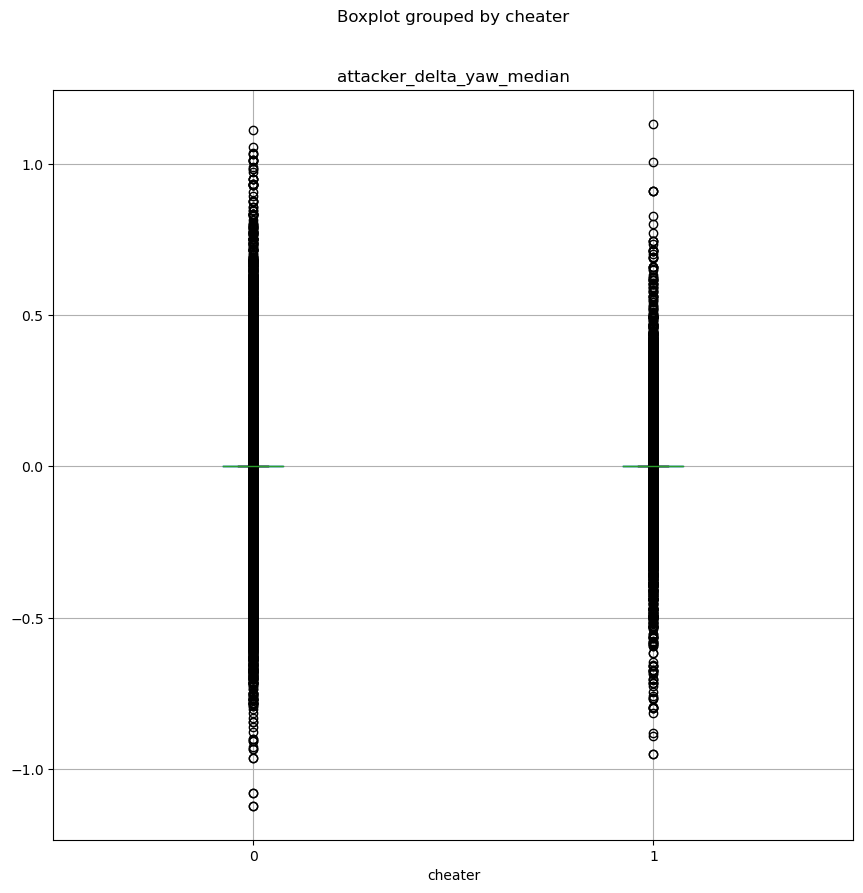

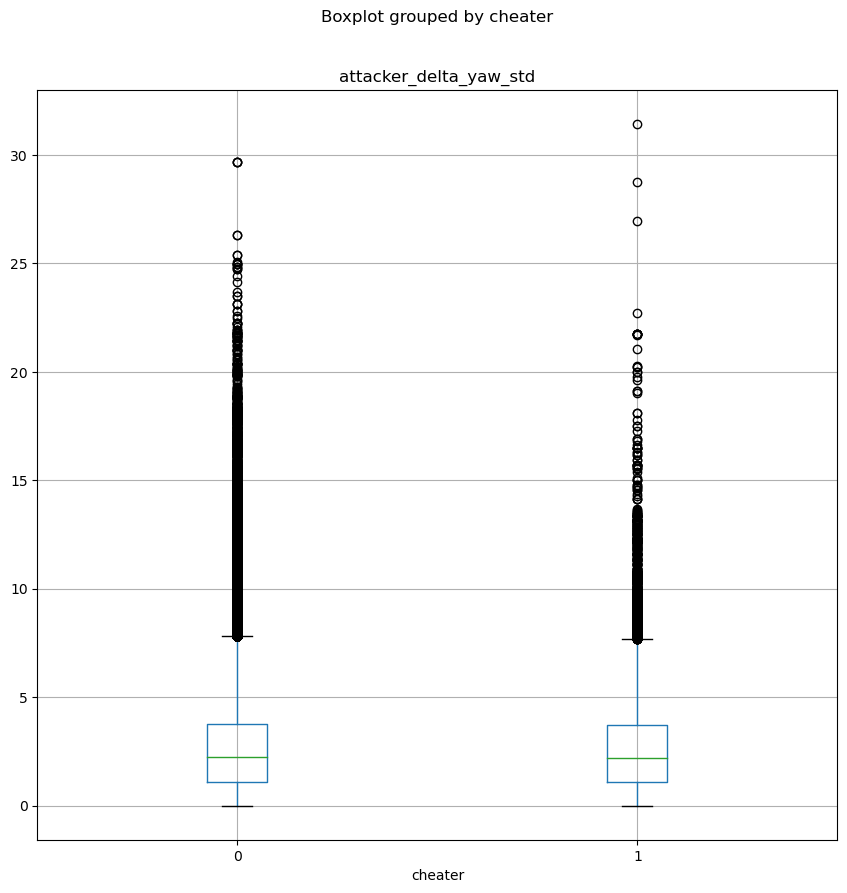

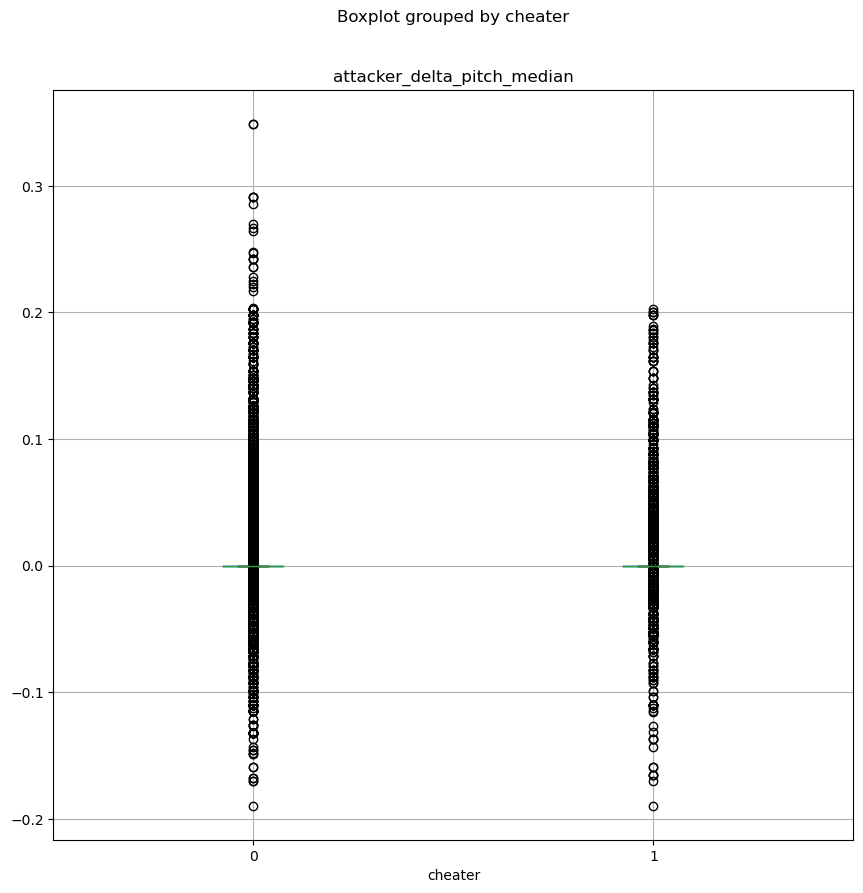

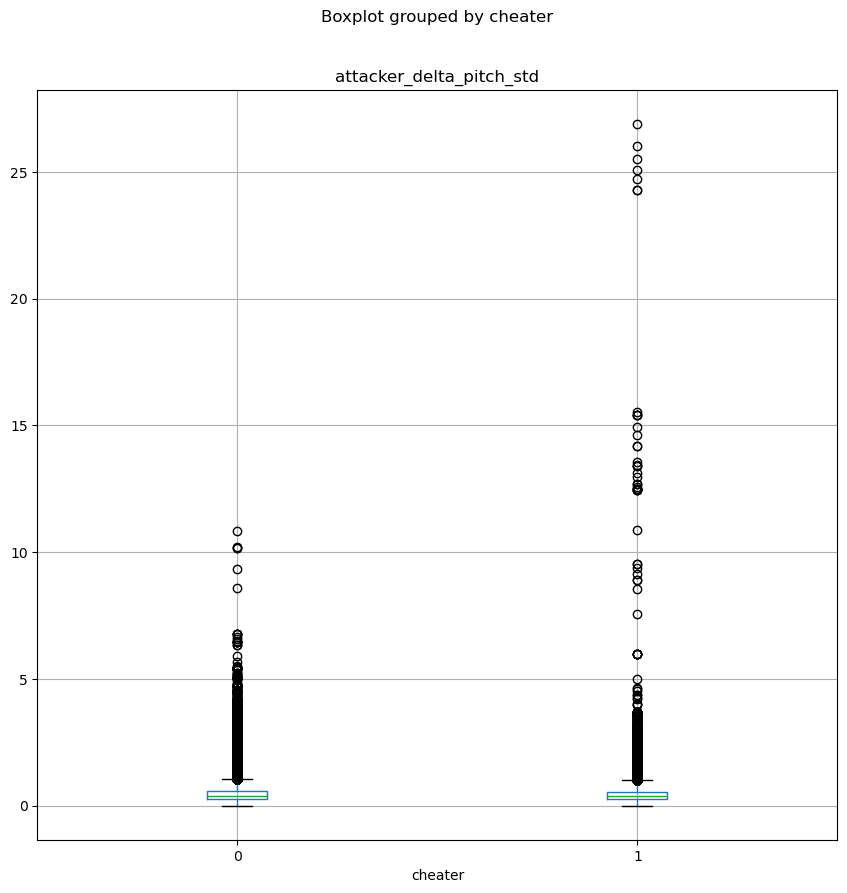

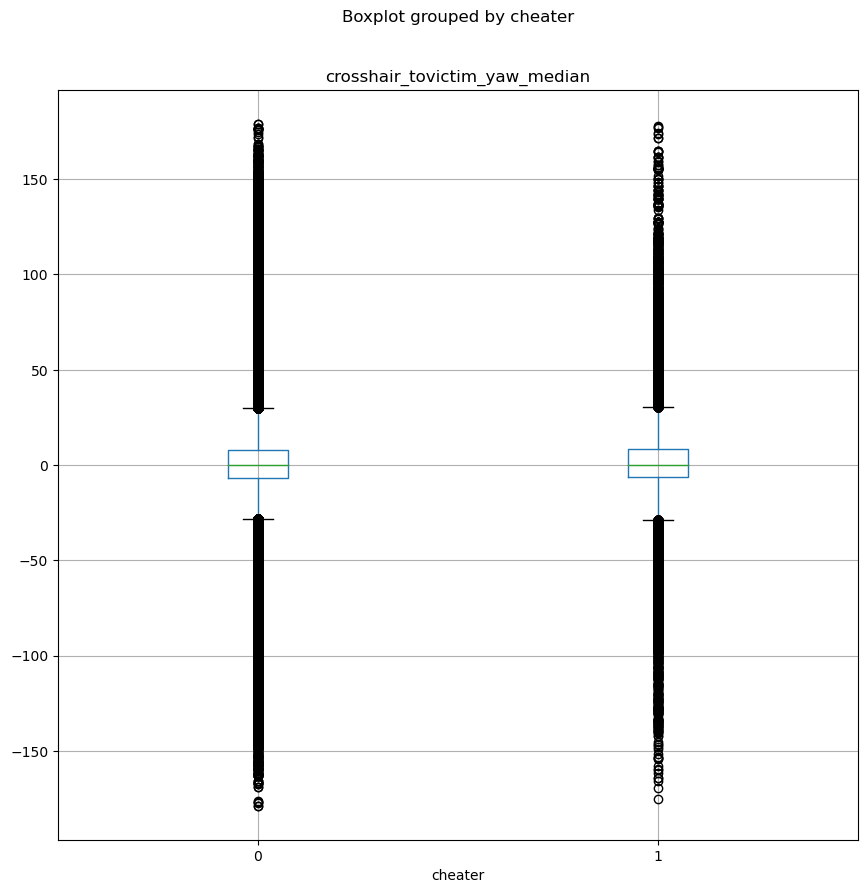

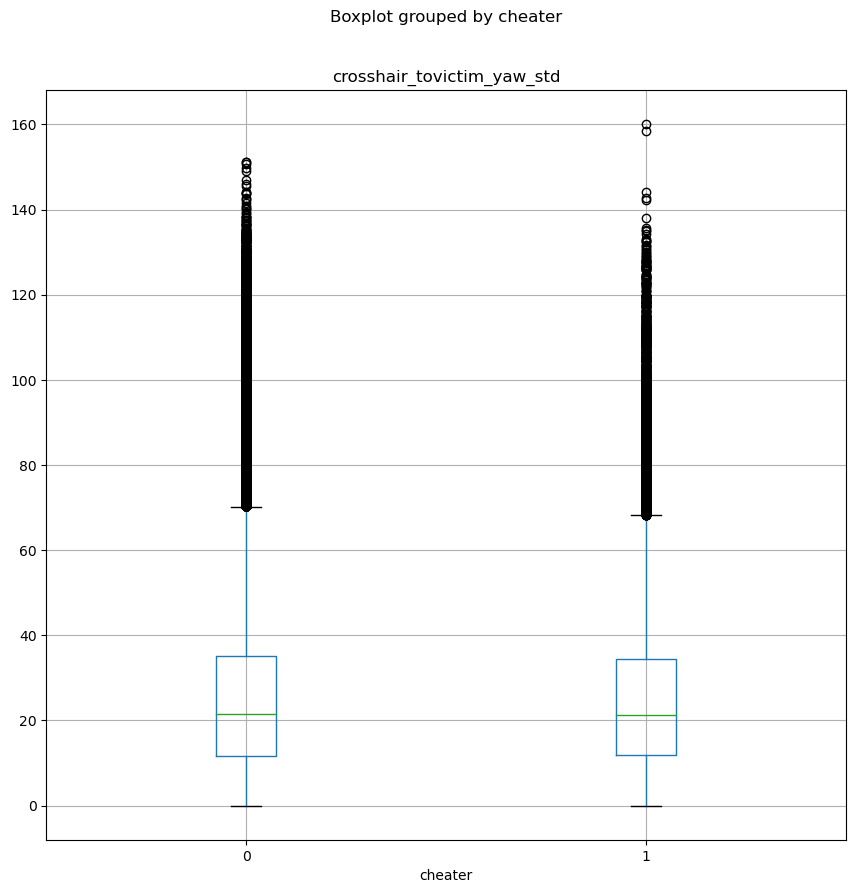

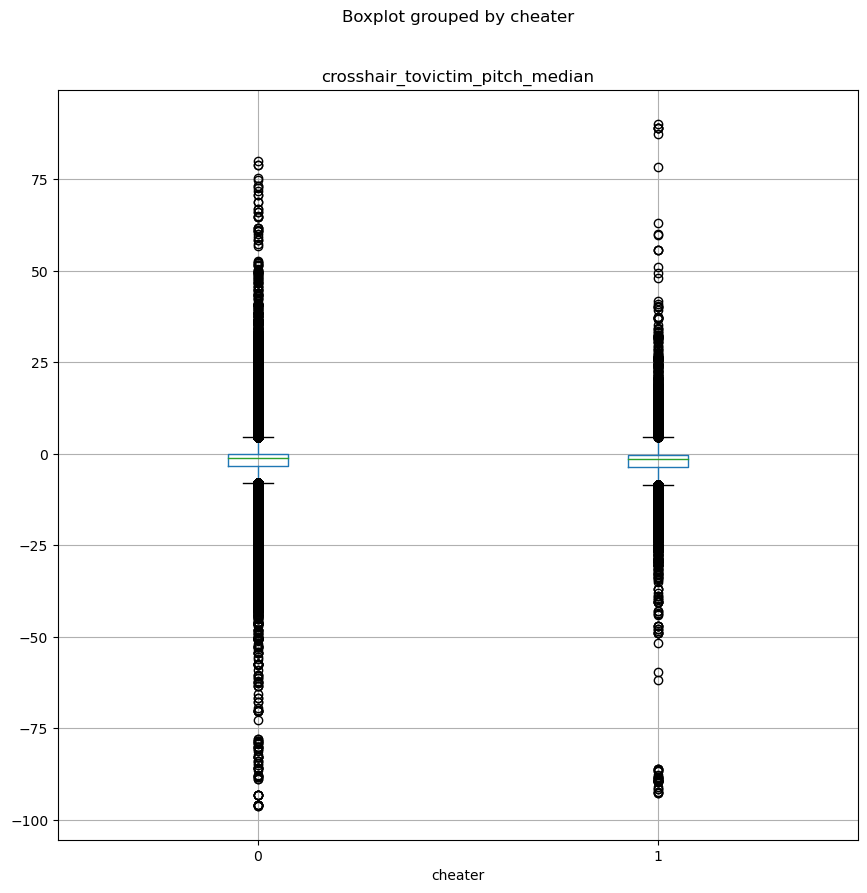

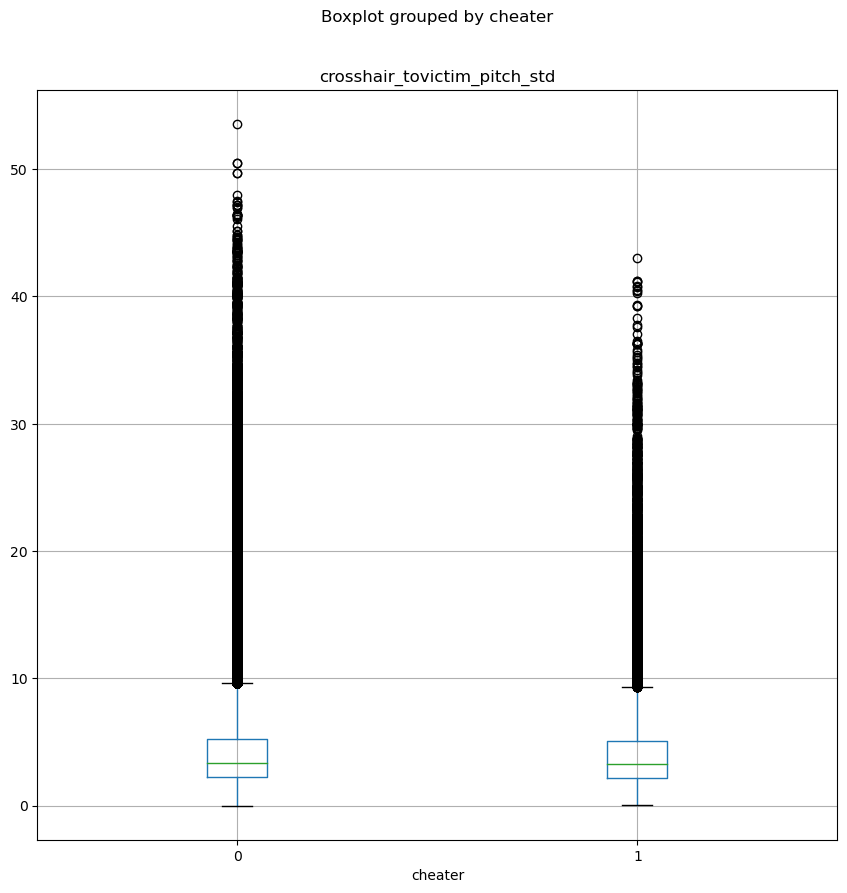

In [10]:
for col in cols_to_plot:
    df_engagement.boxplot(column=col, by="cheater", figsize=(10,10))

### Looking at distributions (particularly std) to see how to aggregate next level

In [14]:
for col in df_engagement.columns:
    result = sp.stats.normaltest(df_engagement[col])
    print('{0} : {1}'.format(col, result))

player_id : NormaltestResult(statistic=319660.2949148809, pvalue=0.0)
engagement_id : NormaltestResult(statistic=327778.93070682185, pvalue=0.0)
attacker_delta_yaw_median : NormaltestResult(statistic=98895.52194739413, pvalue=0.0)
attacker_delta_yaw_std : NormaltestResult(statistic=151436.9198580269, pvalue=0.0)
attacker_delta_pitch_median : NormaltestResult(statistic=380281.9898504929, pvalue=0.0)
attacker_delta_pitch_std : NormaltestResult(statistic=547938.6738096594, pvalue=0.0)
crosshair_tovictim_yaw_median : NormaltestResult(statistic=50535.64614086109, pvalue=0.0)
crosshair_tovictim_yaw_std : NormaltestResult(statistic=103420.28247042613, pvalue=0.0)
crosshair_tovictim_pitch_median : NormaltestResult(statistic=193307.9748385616, pvalue=0.0)
crosshair_tovictim_pitch_std : NormaltestResult(statistic=252479.11032896605, pvalue=0.0)
firing : NormaltestResult(statistic=892642.6412712286, pvalue=0.0)
cheater : NormaltestResult(statistic=102045.1266639893, pvalue=0.0)


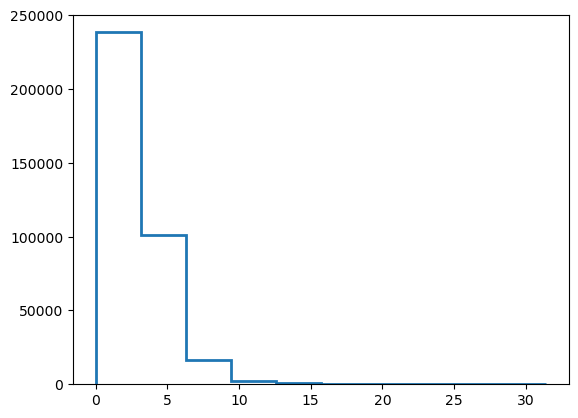

In [20]:
plt.hist(df_engagement.attacker_delta_yaw_std, histtype="step", lw=2)
plt.show()

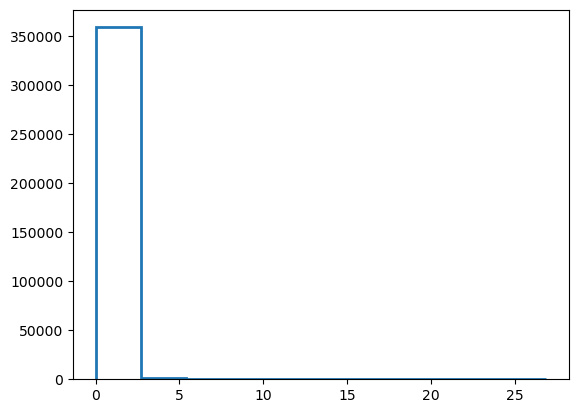

In [21]:
plt.hist(df_engagement.attacker_delta_pitch_std, histtype="step", lw=2)
plt.show()

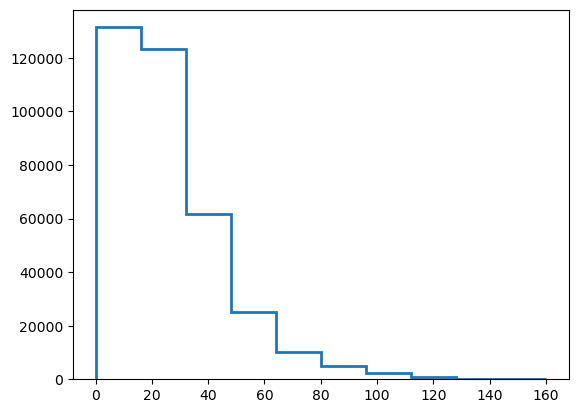

In [22]:
plt.hist(df_engagement.crosshair_tovictim_yaw_std, histtype="step", lw=2)
plt.show()

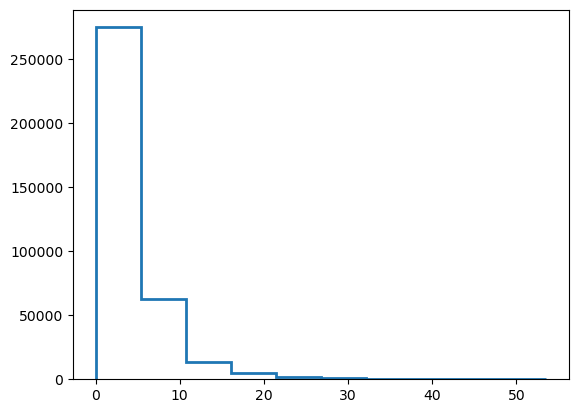

In [23]:
plt.hist(df_engagement.crosshair_tovictim_pitch_std, histtype="step", lw=2)
plt.show()

### All the std distributions are skewed/not normal so when aggregating the next level (over engagement IDs), the median of std would be better than the mean. Let's try the following:
* median of std
* std of std
* rms of std to emphasize larger variations

### I will apply the same aggregates to the medians as well. As for firing and cheater, the mode. Firing column is currently all 1s (if 1 in any timestep within an engagement then aggregate to 1). 

### Second aggregation

In [46]:
df_engagement

,player_id,engagement_id,attacker_delta_yaw_median,attacker_delta_yaw_std,attacker_delta_pitch_median,attacker_delta_pitch_std,crosshair_tovictim_yaw_median,crosshair_tovictim_yaw_std,crosshair_tovictim_pitch_median,crosshair_tovictim_pitch_std,firing,cheater
0,0,0,0.0000,0.812105,0.0,0.151031,-0.5285,7.398991,-1.0170,1.384020,1,1
1,0,1,0.0550,4.517526,0.0,0.257290,42.1180,80.525043,-6.5300,3.922818,1,1
2,0,2,0.0000,2.475721,0.0,0.670827,10.8805,19.078562,-14.6965,12.170717,1,1
3,0,3,0.0000,2.473708,0.0,0.669578,10.4560,19.769224,-14.6965,12.180565,1,1
4,0,4,0.0000,2.473126,0.0,0.671687,9.5950,20.393926,-14.3605,12.188346,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...
359995,11999,25,0.0465,2.742015,0.0,0.419882,-4.6230,23.834550,-0.4460,3.985048,1,0
359996,11999,26,0.0795,2.481271,0.0,0.573610,9.2225,49.997003,-11.8875,7.563940,1,0
359997,11999,27,0.0000,0.625427,0.0,0.281089,43.6825,21.929363,-4.2470,2.148456,1,0
359998,11999,28,0.0000,2.254171,0.0,0.568163,-10.8195,22.199412,-4.1395,4.502174,1,0


In [11]:
def rms(x):
    n = len(x)
    result = np.sqrt((1/n)*np.sum(np.square(x)))
    return result

agg_funcs_player = {"attacker_delta_yaw_median":["median", "std", rms],
                    "attacker_delta_yaw_std":["median", "std", rms],
                    "attacker_delta_pitch_median":["median", "std", rms],
                    "attacker_delta_pitch_std":["median", "std", rms],
                    "crosshair_tovictim_yaw_median": ["median", "std", rms],
                    "crosshair_tovictim_yaw_std": ["median", "std", rms],
                    "crosshair_tovictim_pitch_median":["median", "std", rms],
                    "crosshair_tovictim_pitch_std":["median", "std", rms],
                    "firing": lambda x: x.mode().iloc[0], 
                    "cheater": lambda x: x.mode().iloc[0]}

In [12]:
df_player = df_engagement.groupby(["player_id"]).agg(agg_funcs_player).reset_index()

In [17]:
df_player

player_id attacker_delta_yaw_median                      \
                                   median       std       rms   
0             0                    0.0000  0.010042  0.010042   
1             1                    0.0000  0.063364  0.063816   
2             2                    0.0000  0.090751  0.100817   
3             3                    0.0000  0.078957  0.080207   
4             4                    0.0000  0.010145  0.010627   
...         ...                       ...       ...       ...   
11995     11995                    0.0000  0.106894  0.109885   
11996     11996                    0.0000  0.000000  0.000000   
11997     11997                    0.0000  0.114655  0.112764   
11998     11998                   -0.0245  0.154890  0.167835   
11999     11999                    0.0000  0.096413  0.094963   

      attacker_delta_yaw_std                     attacker_delta_pitch_median  \
                      median       std       rms                      median   
0                   2.474715  2.454349  4.135113                         0.0   
1                   1.130862  2.049870  2.686678                         0.0   
2                   2.894347  1.533714  3.446524                         0.0   
3                   1.552858  1.269806  2.405803                         0.0   
4                   1.895081  3.568884  4.464691                         0.0   
...                      ...       ...       ...                         ...   
11995               2.339309  1.258862  2.996582                         0.0   
11996               1.586222  1.607929  2.499818                         0.0   
11997               1.221080  1.007432  1.821931                         0.0   
11998               1.309347  0.783849  1.599153                         0.0   
11999               2.367721  1.439480  2.802755                         0.0   

                           ... crosshair_tovictim_yaw_std             \
            std       rms  ...                        std        rms   
0      0.000000  0.000000  ...                  17.904421  31.255014   
1      0.000000  0.000000  ...                  25.338421  32.541846   
2      0.004017  0.004017  ...                  12.989298  28.081528   
3      0.011038  0.011710  ...                   9.090097  24.126699   
4      0.004017  0.004017  ...                  16.872671  26.862764   
...         ...       ...  ...                        ...        ...   
11995  0.013954  0.014201  ...                  16.686640  28.454717   
11996  0.000000  0.000000  ...                  16.692256  27.141582   
11997  0.000000  0.000000  ...                  10.040479  22.183191   
11998  0.012432  0.012652  ...                  12.077810  24.566777   
11999  0.000000  0.000000  ...                  27.099279  42.234499   

      crosshair_tovictim_pitch_median                      \
                               median       std       rms   
0                            -4.30250  4.788217  7.001038   
1                            -1.84450  2.948715  3.623663   
2                            -1.30225  3.920730  4.189308   
3                            -2.00100  5.931635  6.091372   
4                            -1.86175  4.852536  4.924784   
...                               ...       ...       ...   
11995                        -1.97250  1.279913  2.024512   
11996                         0.16000  2.716837  2.671579   
11997                        -1.81850  2.585810  3.262878   
11998                        -1.19975  2.867097  3.736978   
11999                        -2.87450  2.969085  3.897299   

      crosshair_tovictim_pitch_std                       firing  cheater  
                            median       std       rms <lambda> <lambda>  
0                         3.492373  3.476035  5.637447        1        1  
1                         2.608983  1.711395  3.313039        1        1  
2                         4.445297  2.947616  5.188267        1        1  
3            

In [13]:
df_player.columns = ['_'.join(col).strip() for col in df_player.columns.values]

In [19]:
df_player

,player_id_,attacker_delta_yaw_median_median,attacker_delta_yaw_median_std,attacker_delta_yaw_median_rms,attacker_delta_yaw_std_median,attacker_delta_yaw_std_std,attacker_delta_yaw_std_rms,attacker_delta_pitch_median_median,attacker_delta_pitch_median_std,attacker_delta_pitch_median_rms,...,crosshair_tovictim_yaw_std_std,crosshair_tovictim_yaw_std_rms,crosshair_tovictim_pitch_median_median,crosshair_tovictim_pitch_median_std,crosshair_tovictim_pitch_median_rms,crosshair_tovictim_pitch_std_median,crosshair_tovictim_pitch_std_std,crosshair_tovictim_pitch_std_rms,firing_<lambda>,cheater_<lambda>
0,0,0.0000,0.010042,0.010042,2.474715,2.454349,4.135113,0.0,0.000000,0.000000,...,17.904421,31.255014,-4.30250,4.788217,7.001038,3.492373,3.476035,5.637447,1,1
1,1,0.0000,0.063364,0.063816,1.130862,2.049870,2.686678,0.0,0.000000,0.000000,...,25.338421,32.541846,-1.84450,2.948715,3.623663,2.608983,1.711395,3.313039,1,1
2,2,0.0000,0.090751,0.100817,2.894347,1.533714,3.446524,0.0,0.004017,0.004017,...,12.989298,28.081528,-1.30225,3.920730,4.189308,4.445297,2.947616,5.188267,1,1
3,3,0.0000,0.078957,0.080207,1.552858,1.269806,2.405803,0.0,0.011038,0.011710,...,9.090097,24.126699,-2.00100,5.931635,6.091372,4.375141,1.410894,4.396143,1,1
4,4,0.0000,0.010145,0.010627,1.895081,3.568884,4.464691,0.0,0.004017,0.004017,...,16.872671,26.862764,-1.86175,4.852536,4.924784,5.076540,2.320273,4.970957,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11995,11995,0.0000,0.106894,0.109885,2.339309,1.258862,2.996582,0.0,0.013954,0.014201,...,16.686640,28.454717,-1.97250,1.279913,2.024512,3.726337,0.795705,3.467410,1,0
11996,11996,0.0000,0.000000,0.000000,1.586222,1.607929,2.499818,0.0,0.000000,0.000000,...,16.692256,27.141582,0.16000,2.716837,2.671579,3.196874,1.704226,3.905123,1,0
11997,11997,0.0000,0.114655,0.112764,1.221080,1.007432,1.821931,0.0,0.000000,0.000000,...,10.040479,22.183191,-1.81850,2.585810,3.262878,3.174009,2.616725,4.812721,1,0
11998,11998,-0.0245,0.154890,0.167835,1.309347,0.783849,1.599153,0.0,0.012432,0.012652,...,12.077810,24.566777,-1.19975,2.867097,3.736978,2.642608,1.125447,3.205389,1,0


In [14]:
df_player.rename(columns={"player_id_": "player_id", "firing_<lambda>":"firing", 
                          "cheater_<lambda>": "cheater"}, inplace=True)

In [21]:
df_player

,player_id,attacker_delta_yaw_median_median,attacker_delta_yaw_median_std,attacker_delta_yaw_median_rms,attacker_delta_yaw_std_median,attacker_delta_yaw_std_std,attacker_delta_yaw_std_rms,attacker_delta_pitch_median_median,attacker_delta_pitch_median_std,attacker_delta_pitch_median_rms,...,crosshair_tovictim_yaw_std_std,crosshair_tovictim_yaw_std_rms,crosshair_tovictim_pitch_median_median,crosshair_tovictim_pitch_median_std,crosshair_tovictim_pitch_median_rms,crosshair_tovictim_pitch_std_median,crosshair_tovictim_pitch_std_std,crosshair_tovictim_pitch_std_rms,firing,cheater
0,0,0.0000,0.010042,0.010042,2.474715,2.454349,4.135113,0.0,0.000000,0.000000,...,17.904421,31.255014,-4.30250,4.788217,7.001038,3.492373,3.476035,5.637447,1,1
1,1,0.0000,0.063364,0.063816,1.130862,2.049870,2.686678,0.0,0.000000,0.000000,...,25.338421,32.541846,-1.84450,2.948715,3.623663,2.608983,1.711395,3.313039,1,1
2,2,0.0000,0.090751,0.100817,2.894347,1.533714,3.446524,0.0,0.004017,0.004017,...,12.989298,28.081528,-1.30225,3.920730,4.189308,4.445297,2.947616,5.188267,1,1
3,3,0.0000,0.078957,0.080207,1.552858,1.269806,2.405803,0.0,0.011038,0.011710,...,9.090097,24.126699,-2.00100,5.931635,6.091372,4.375141,1.410894,4.396143,1,1
4,4,0.0000,0.010145,0.010627,1.895081,3.568884,4.464691,0.0,0.004017,0.004017,...,16.872671,26.862764,-1.86175,4.852536,4.924784,5.076540,2.320273,4.970957,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11995,11995,0.0000,0.106894,0.109885,2.339309,1.258862,2.996582,0.0,0.013954,0.014201,...,16.686640,28.454717,-1.97250,1.279913,2.024512,3.726337,0.795705,3.467410,1,0
11996,11996,0.0000,0.000000,0.000000,1.586222,1.607929,2.499818,0.0,0.000000,0.000000,...,16.692256,27.141582,0.16000,2.716837,2.671579,3.196874,1.704226,3.905123,1,0
11997,11997,0.0000,0.114655,0.112764,1.221080,1.007432,1.821931,0.0,0.000000,0.000000,...,10.040479,22.183191,-1.81850,2.585810,3.262878,3.174009,2.616725,4.812721,1,0
11998,11998,-0.0245,0.154890,0.167835,1.309347,0.783849,1.599153,0.0,0.012432,0.012652,...,12.077810,24.566777,-1.19975,2.867097,3.736978,2.642608,1.125447,3.205389,1,0


In [64]:
df_engagement.to_csv("df_engagement.csv", index=False)
df_player.to_csv("df_player.csv", index=False)

### At the engagement level, there doesn't seem to be much separation between cheaters and non-cheaters for any of these variables. Let's try at the player level. 

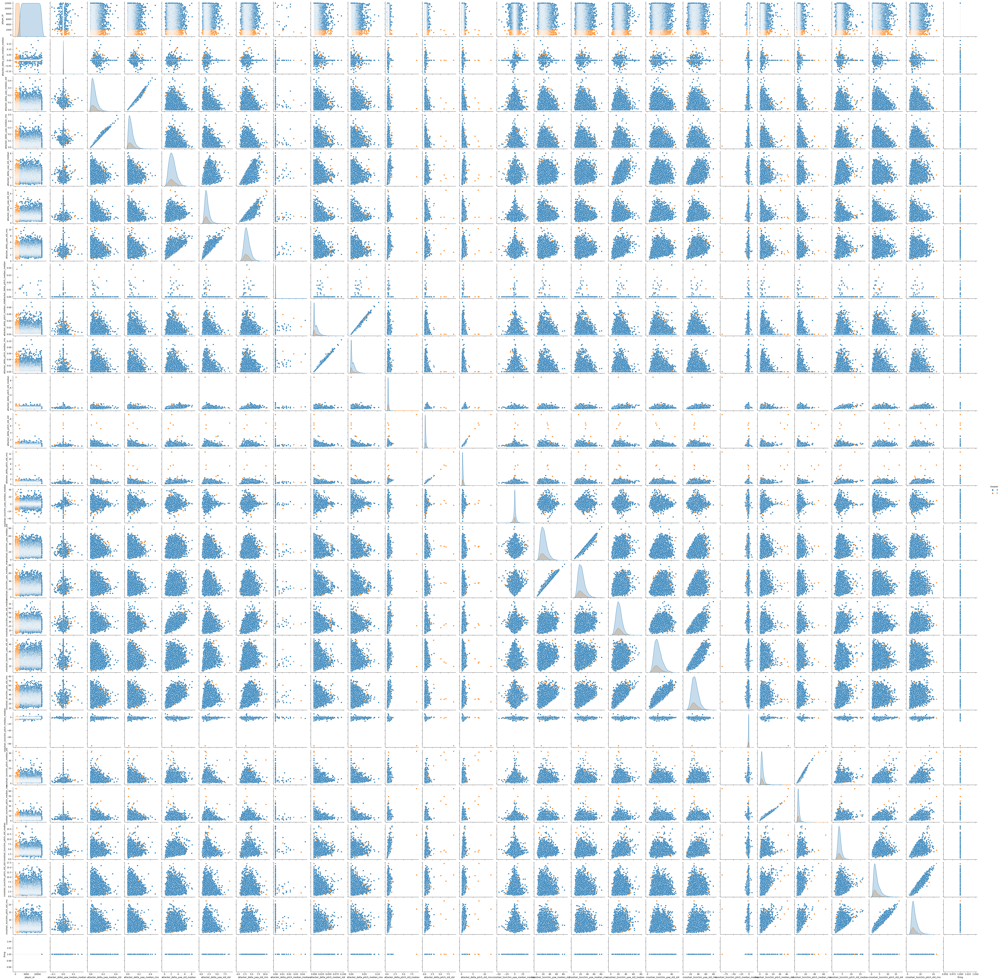

In [70]:
sns.pairplot(df_player, hue="cheater")

### At the player level, there doesn't seem to be much separation between cheaters and non-cheaters for any of these variables either by looking at the 1D distributions. Next, boxplots per variable grouped by "cheater" column.

array([[<AxesSubplot:title={'center':'attacker_delta_pitch_median_median'}, xlabel='[cheater]'>,
        <AxesSubplot:title={'center':'attacker_delta_pitch_median_rms'}, xlabel='[cheater]'>,
        <AxesSubplot:title={'center':'attacker_delta_pitch_median_std'}, xlabel='[cheater]'>],
       [<AxesSubplot:title={'center':'attacker_delta_pitch_std_median'}, xlabel='[cheater]'>,
        <AxesSubplot:title={'center':'attacker_delta_pitch_std_rms'}, xlabel='[cheater]'>,
        <AxesSubplot:title={'center':'attacker_delta_pitch_std_std'}, xlabel='[cheater]'>],
       [<AxesSubplot:title={'center':'attacker_delta_yaw_median_median'}, xlabel='[cheater]'>,
        <AxesSubplot:title={'center':'attacker_delta_yaw_median_rms'}, xlabel='[cheater]'>,
        <AxesSubplot:title={'center':'attacker_delta_yaw_median_std'}, xlabel='[cheater]'>],
       [<AxesSubplot:title={'center':'attacker_delta_yaw_std_median'}, xlabel='[cheater]'>,
        <AxesSubplot:title={'center':'attacker_delta_yaw_std_rms'

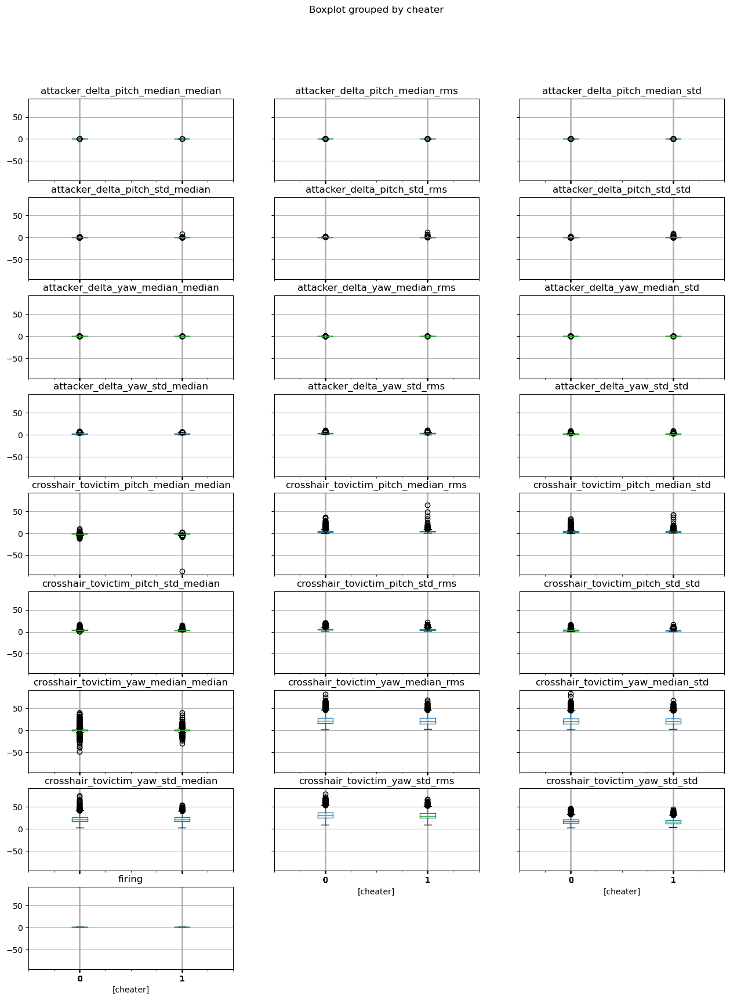

In [18]:
df_player.loc[:,~df_player.columns.isin(["player_id"])].boxplot(by="cheater", figsize=(15,20), layout=(9,3))

### Next is to confirm this a bit more robustly, using KS tests to compare distributions between cheaters and non-cheaters since visual inspection alone isn't always sufficient to determine how informative variables are.

In [21]:
df_engagement = pd.read_csv("df_engagement.csv")
df_player = pd.read_csv("df_player.csv")

In [119]:
df_engagement_subset = df_engagement.loc[:, ~df_engagement.columns.isin(["player_id","engagement_id"])]
df_player_subset = df_player.loc[:, ~df_player.columns.isin(["player_id"])]

In [23]:
df_engagement_subset

,attacker_delta_yaw_median,attacker_delta_yaw_std,attacker_delta_pitch_median,attacker_delta_pitch_std,crosshair_tovictim_yaw_median,crosshair_tovictim_yaw_std,crosshair_tovictim_pitch_median,crosshair_tovictim_pitch_std,firing,cheater
0,0.0000,0.812105,0.0,0.151031,-0.5285,7.398991,-1.0170,1.384020,1,1
1,0.0550,4.517526,0.0,0.257290,42.1180,80.525043,-6.5300,3.922818,1,1
2,0.0000,2.475721,0.0,0.670827,10.8805,19.078562,-14.6965,12.170717,1,1
3,0.0000,2.473708,0.0,0.669578,10.4560,19.769224,-14.6965,12.180565,1,1
4,0.0000,2.473126,0.0,0.671687,9.5950,20.393926,-14.3605,12.188346,1,1
...,...,...,...,...,...,...,...,...,...,...
359995,0.0465,2.742015,0.0,0.419882,-4.6230,23.834550,-0.4460,3.985048,1,0
359996,0.0795,2.481271,0.0,0.573610,9.2225,49.997003,-11.8875,7.563940,1,0
359997,0.0000,0.625427,0.0,0.281089,43.6825,21.929363,-4.2470,2.148456,1,0
359998,0.0000,2.254171,0.0,0.568163,-10.8195,22.199412,-4.1395,4.502174,1,0


In [24]:
df_player_subset

,attacker_delta_yaw_median_median,attacker_delta_yaw_median_std,attacker_delta_yaw_median_rms,attacker_delta_yaw_std_median,attacker_delta_yaw_std_std,attacker_delta_yaw_std_rms,attacker_delta_pitch_median_median,attacker_delta_pitch_median_std,attacker_delta_pitch_median_rms,attacker_delta_pitch_std_median,...,crosshair_tovictim_yaw_std_std,crosshair_tovictim_yaw_std_rms,crosshair_tovictim_pitch_median_median,crosshair_tovictim_pitch_median_std,crosshair_tovictim_pitch_median_rms,crosshair_tovictim_pitch_std_median,crosshair_tovictim_pitch_std_std,crosshair_tovictim_pitch_std_rms,firing,cheater
0,0.0000,0.010042,0.010042,2.474715,2.454349,4.135113,0.0,0.000000,0.000000,0.320259,...,17.904421,31.255014,-4.30250,4.788217,7.001038,3.492373,3.476035,5.637447,1,1
1,0.0000,0.063364,0.063816,1.130862,2.049870,2.686678,0.0,0.000000,0.000000,0.316883,...,25.338421,32.541846,-1.84450,2.948715,3.623663,2.608983,1.711395,3.313039,1,1
2,0.0000,0.090751,0.100817,2.894347,1.533714,3.446524,0.0,0.004017,0.004017,0.321959,...,12.989298,28.081528,-1.30225,3.920730,4.189308,4.445297,2.947616,5.188267,1,1
3,0.0000,0.078957,0.080207,1.552858,1.269806,2.405803,0.0,0.011038,0.011710,0.291583,...,9.090097,24.126699,-2.00100,5.931635,6.091372,4.375141,1.410894,4.396143,1,1
4,0.0000,0.010145,0.010627,1.895081,3.568884,4.464691,0.0,0.004017,0.004017,0.277052,...,16.872671,26.862764,-1.86175,4.852536,4.924784,5.076540,2.320273,4.970957,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11995,0.0000,0.106894,0.109885,2.339309,1.258862,2.996582,0.0,0.013954,0.014201,0.449998,...,16.686640,28.454717,-1.97250,1.279913,2.024512,3.726337,0.795705,3.467410,1,0
11996,0.0000,0.000000,0.000000,1.586222,1.607929,2.499818,0.0,0.000000,0.000000,0.328268,...,16.692256,27.141582,0.16000,2.716837,2.671579,3.196874,1.704226,3.905123,1,0
11997,0.0000,0.114655,0.112764,1.221080,1.007432,1.821931,0.0,0.000000,0.000000,0.243238,...,10.040479,22.183191,-1.81850,2.585810,3.262878,3.174009,2.616725,4.812721,1,0
11998,-0.0245,0.154890,0.167835,1.309347,0.783849,1.599153,0.0,0.012432,0.012652,0.252850,...,12.077810,24.566777,-1.19975,2.867097,3.736978,2.642608,1.125447,3.205389,1,0


### KS-test for engagement subset

In [25]:
for col in df_engagement_subset.columns[:-2]:
    cheaters = df_engagement_subset.loc[df_engagement_subset.cheater == 1][col]
    noncheaters = df_engagement_subset.loc[df_engagement_subset.cheater == 0][col]
    result = sp.stats.ks_2samp(cheaters, noncheaters)
    print("{0} - stat: {1}, p-value: {2}".format(col, result[0], result[1]))

attacker_delta_yaw_median - stat: 0.01347000000000001, p-value: 2.611974434610793e-08
attacker_delta_yaw_std - stat: 0.011153333333333348, p-value: 7.85577434519098e-06
attacker_delta_pitch_median - stat: 0.012750000000000039, p-value: 1.7262947590516766e-07
attacker_delta_pitch_std - stat: 0.02249000000000001, p-value: 2.1160509923243556e-22
crosshair_tovictim_yaw_median - stat: 0.007383333333333297, p-value: 0.008538430771805345
crosshair_tovictim_yaw_std - stat: 0.010936666666666595, p-value: 1.2680099578397415e-05
crosshair_tovictim_pitch_median - stat: 0.04845333333333335, p-value: 1.8782780743346364e-102
crosshair_tovictim_pitch_std - stat: 0.02371333333333331, p-value: 7.411005232719689e-25


### The <0.05 p-values confirm that the null hypothesis (that both samples came from the same distribution) can be rejected. This contradicts what I observed in the visual inspection which could either indicate subtle differences that are not easily visible but might be important for classification or due to the large sample size, the KS test is too sensitive to even the smallest of differences.

### KS-test for player subset


In [26]:
for col in df_player_subset.columns[:-2]:
    cheaters = df_player_subset.loc[df_player_subset.cheater == 1][col]
    noncheaters = df_player_subset.loc[df_player_subset.cheater == 0][col]
    result = sp.stats.ks_2samp(cheaters, noncheaters)
    print("{0} - stat: {1}, p-value: {2}".format(col, result[0], result[1]))

attacker_delta_yaw_median_median - stat: 0.0041, p-value: 1.0
attacker_delta_yaw_median_std - stat: 0.0271, p-value: 0.1707511572679864
attacker_delta_yaw_median_rms - stat: 0.0281, p-value: 0.142024485148451
attacker_delta_yaw_std_median - stat: 0.0308, p-value: 0.08350300318962722
attacker_delta_yaw_std_std - stat: 0.0771, p-value: 4.700321354356163e-09
attacker_delta_yaw_std_rms - stat: 0.062, p-value: 5.260011490260119e-06
attacker_delta_pitch_median_median - stat: 0.0009, p-value: 1.0
attacker_delta_pitch_median_std - stat: 0.0759, p-value: 8.683765373440622e-09
attacker_delta_pitch_median_rms - stat: 0.0753, p-value: 1.1760469487143155e-08
attacker_delta_pitch_std_median - stat: 0.0537, p-value: 0.00013013040422527045
attacker_delta_pitch_std_std - stat: 0.0472, p-value: 0.0011637787547600364
attacker_delta_pitch_std_rms - stat: 0.0605, p-value: 9.719127562535235e-06
crosshair_tovictim_yaw_median_median - stat: 0.0275, p-value: 0.15875169818949963
crosshair_tovictim_yaw_median_st

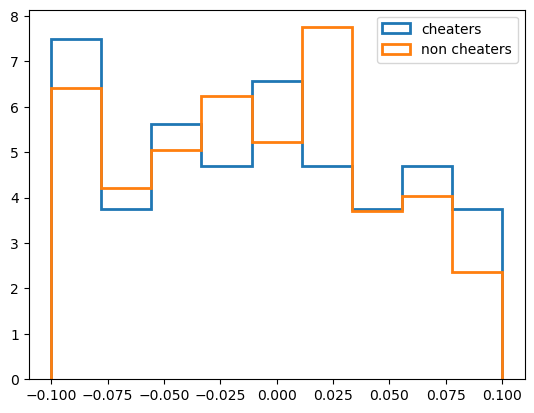

In [27]:
col = "crosshair_tovictim_pitch_median_median" #visualizing case where p-value is <<<0.05
cheaters = df_player_subset.loc[df_player_subset.cheater == 1][col]
noncheaters = df_player_subset.loc[df_player_subset.cheater == 0][col]
plt.hist(cheaters, histtype="step", lw=2, label="cheaters", bins = np.linspace(-0.1, 0.1, 10), density=True)
plt.hist(noncheaters, histtype="step", lw=2, label="non cheaters",bins = np.linspace(-0.1, 0.1, 10), density=True)
plt.legend(loc="best")

### It seems there are some parameters for which the null hypothesis can be rejected (i.e. their cheaters vs non cheaters distributions are not identical): 
1. attacker delta yaw std - std and rms
2. attacker delta pitch median - std and rms
3. attacker delta pitch std - median, std and rms
4. crosshair tovictim yaw median - std and rms
5. crosshair tovictim yaw std - std and rms
6. crosshair tovictim pitch median - median and rms
7. crosshair tovictim pitch std - median, std and rms

### Going to shelf this for now and use feature importance to see if any features are relevant

### Next, feature importance using RandomForestClassifier on engagement subset

In [25]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split

In [29]:
X = df_engagement_subset.drop(["firing", "cheater"], axis=1)

In [30]:
X

,attacker_delta_yaw_median,attacker_delta_yaw_std,attacker_delta_pitch_median,attacker_delta_pitch_std,crosshair_tovictim_yaw_median,crosshair_tovictim_yaw_std,crosshair_tovictim_pitch_median,crosshair_tovictim_pitch_std
0,0.0000,0.812105,0.0,0.151031,-0.5285,7.398991,-1.0170,1.384020
1,0.0550,4.517526,0.0,0.257290,42.1180,80.525043,-6.5300,3.922818
2,0.0000,2.475721,0.0,0.670827,10.8805,19.078562,-14.6965,12.170717
3,0.0000,2.473708,0.0,0.669578,10.4560,19.769224,-14.6965,12.180565
4,0.0000,2.473126,0.0,0.671687,9.5950,20.393926,-14.3605,12.188346
...,...,...,...,...,...,...,...,...
359995,0.0465,2.742015,0.0,0.419882,-4.6230,23.834550,-0.4460,3.985048
359996,0.0795,2.481271,0.0,0.573610,9.2225,49.997003,-11.8875,7.563940
359997,0.0000,0.625427,0.0,0.281089,43.6825,21.929363,-4.2470,2.148456
359998,0.0000,2.254171,0.0,0.568163,-10.8195,22.199412,-4.1395,4.502174


In [31]:
y = df_engagement_subset.cheater

In [32]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=31, stratify=y)

In [33]:
rf = RandomForestClassifier(random_state=31)
rf.fit(X_train, y_train)

RandomForestClassifier(random_state=31)

In [34]:
rf.feature_importances_

array([0.0496509 , 0.15875796, 0.01206707, 0.15644714, 0.1588478 ,
       0.15353789, 0.15643526, 0.15425597])

In [35]:
X.columns

Index(['attacker_delta_yaw_median', 'attacker_delta_yaw_std',
       'attacker_delta_pitch_median', 'attacker_delta_pitch_std',
       'crosshair_tovictim_yaw_median', 'crosshair_tovictim_yaw_std',
       'crosshair_tovictim_pitch_median', 'crosshair_tovictim_pitch_std'],
      dtype='object')

In [36]:
df_feature_importance_engagement = pd.DataFrame({"feature":X.columns,"importance":rf.feature_importances_}).\
    sort_values("importance", ascending=False)

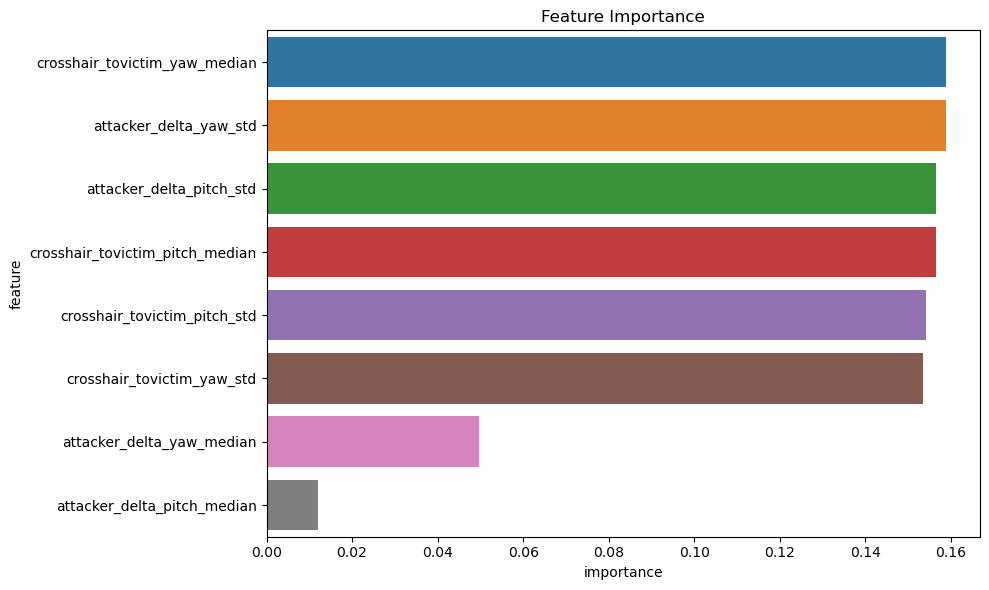

In [213]:
# Visualize feature importance
plt.figure(figsize=(10, 6))
sns.barplot(x='importance', y='feature', data=df_feature_importance_engagement)
plt.title('Feature Importance')
plt.tight_layout()
plt.show()

In [38]:
df_feature_importance_engagement

,feature,importance
4,crosshair_tovictim_yaw_median,0.158848
1,attacker_delta_yaw_std,0.158758
3,attacker_delta_pitch_std,0.156447
6,crosshair_tovictim_pitch_median,0.156435
7,crosshair_tovictim_pitch_std,0.154256
5,crosshair_tovictim_yaw_std,0.153538
0,attacker_delta_yaw_median,0.049651
2,attacker_delta_pitch_median,0.012067


### Next, feature importance using RandomForestClassifier on player subset

In [39]:
X = df_player_subset.drop(["firing", "cheater"], axis=1)
y = df_player_subset.cheater

In [40]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=31, stratify=y)

In [41]:
rf_player = RandomForestClassifier(random_state=31)
rf_player.fit(X_train, y_train)

RandomForestClassifier(random_state=31)

In [42]:
df_feature_importance_player = pd.DataFrame({"feature":X.columns,"importance":rf_player.feature_importances_}).\
    sort_values("importance", ascending=False)

In [43]:
df_feature_importance_player

,feature,importance
18,crosshair_tovictim_pitch_median_median,0.059829
21,crosshair_tovictim_pitch_std_median,0.052544
9,attacker_delta_pitch_std_median,0.051624
12,crosshair_tovictim_yaw_median_median,0.048872
4,attacker_delta_yaw_std_std,0.048283
16,crosshair_tovictim_yaw_std_std,0.047671
10,attacker_delta_pitch_std_std,0.047366
15,crosshair_tovictim_yaw_std_median,0.046971
11,attacker_delta_pitch_std_rms,0.046663
3,attacker_delta_yaw_std_median,0.046653


<AxesSubplot:>

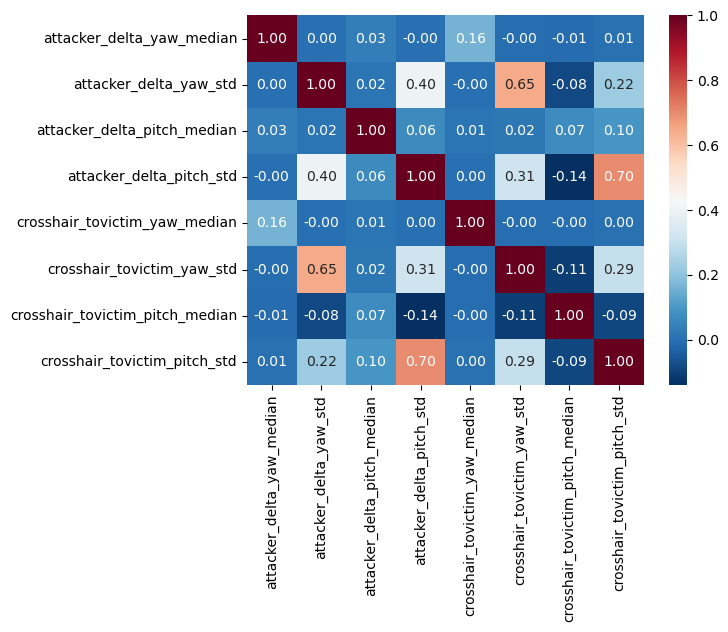

In [126]:
sns.heatmap(df_engagement_subset.iloc[:,:8].corr(), annot=True, fmt=".2f", cmap="RdBu_r")

In [83]:
# code from https://datascience.stackexchange.com/questions/52570/automatically-remove-highly-correlated-features-using-variance-inflation-factor
corr_matrix = df_engagement_subset.corr().abs()
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))

/Users/asadm2/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  This is separate from the ipykernel package so we can avoid doing imports until


In [84]:
to_drop_engagement = [column for column in upper.columns if any(upper[column] > 0.8)]
to_drop_engagement

[]

<AxesSubplot:>

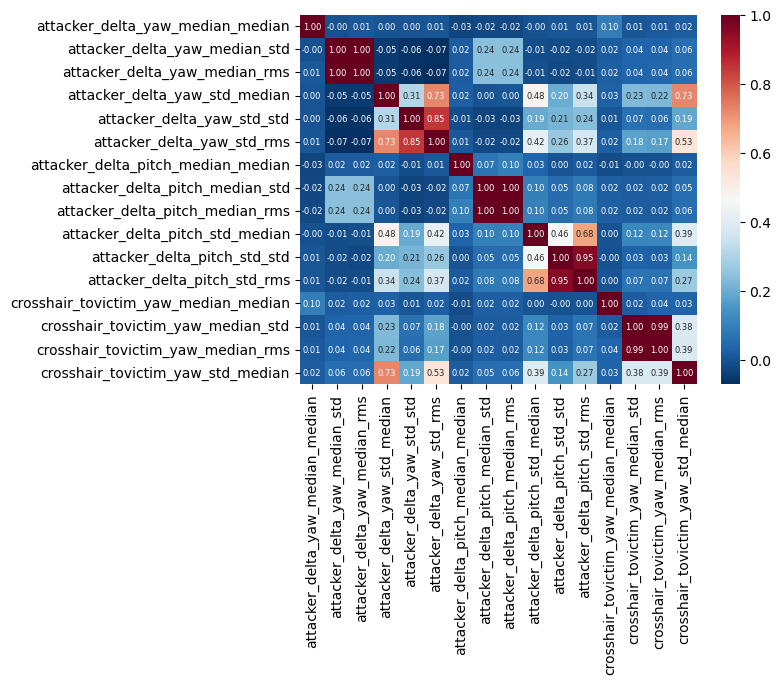

In [132]:
sns.heatmap(df_player_subset.iloc[:,:16].corr(), annot=True, fmt=".2f", annot_kws={"size":6}, cmap="RdBu_r")

In [133]:
# code from https://datascience.stackexchange.com/questions/52570/automatically-remove-highly-correlated-features-using-variance-inflation-factor
corr_matrix = df_player_subset.corr().abs()
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))

/Users/asadm2/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  This is separate from the ipykernel package so we can avoid doing imports until


In [134]:
to_drop_player = [column for column in upper.columns if any(upper[column] > 0.8)]
to_drop_player

['attacker_delta_yaw_median_rms',
 'attacker_delta_yaw_std_rms',
 'attacker_delta_pitch_median_rms',
 'attacker_delta_pitch_std_rms',
 'crosshair_tovictim_yaw_median_rms',
 'crosshair_tovictim_yaw_std_rms',
 'crosshair_tovictim_pitch_median_rms',
 'crosshair_tovictim_pitch_std_rms']

In [135]:
df_player_subset = df_player_subset.drop(to_drop_player, axis=1)

### Actually, to more robustly do feature importance, I'm going to include cross-validation

### Engagement subset

In [406]:
from sklearn.model_selection import StratifiedKFold
from imblearn.over_sampling import SMOTE

In [407]:
def cv_feature_importance(X, y, n_splits):
    cv = StratifiedKFold(n_splits, shuffle=True, random_state=31)
    smote = SMOTE(random_state=31)
    rf_cv = RandomForestClassifier()

    for fold_num, (train_idx, test_idx) in enumerate(cv.split(X,y)):
        X_train = X.iloc[train_idx]
        y_train = y.iloc[train_idx]
        X_test = X.iloc[test_idx]
        y_test = y.iloc[test_idx]
        
        X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)
        rf_cv.fit(X_train_resampled, y_train_resampled)

        if fold_num == 0:
            df_feature_importance = pd.DataFrame({"fold_num":len(X.columns)*[fold_num], "feature":X.columns,"importance":rf_cv.feature_importances_}).\
                sort_values("importance", ascending=False)
        else:
            temp_df = pd.DataFrame({"fold_num":len(X.columns)*[fold_num], "feature":X.columns, \
                                    "importance":rf_cv.feature_importances_}).\
                sort_values("importance", ascending=False)
            df_feature_importance = df_feature_importance.append(temp_df, ignore_index=True)
    
    return df_feature_importance

In [409]:
X = df_engagement_subset.drop(["firing", "cheater"], axis=1)
y = df_engagement_subset.cheater
cv_engagement_df = cv_feature_importance(X, y, 5)

In [410]:
cv_engagement_df

,fold_num,feature,importance
0,0,crosshair_tovictim_yaw_median,0.163434
1,0,crosshair_tovictim_yaw_std,0.157309
2,0,crosshair_tovictim_pitch_median,0.145339
3,0,attacker_delta_yaw_std,0.145001
4,0,crosshair_tovictim_pitch_std,0.142077
5,0,attacker_delta_pitch_std,0.133497
6,0,attacker_delta_yaw_median,0.090974
7,0,attacker_delta_pitch_median,0.022369
8,1,crosshair_tovictim_yaw_median,0.162529
9,1,crosshair_tovictim_yaw_std,0.157496


In [411]:
cv_engagement_df["rank"] = cv_engagement_df.groupby("fold_num")["importance"].rank("max", ascending=False)

In [412]:
cv_engagement_df

,fold_num,feature,importance,rank
0,0,crosshair_tovictim_yaw_median,0.163434,1.0
1,0,crosshair_tovictim_yaw_std,0.157309,2.0
2,0,crosshair_tovictim_pitch_median,0.145339,3.0
3,0,attacker_delta_yaw_std,0.145001,4.0
4,0,crosshair_tovictim_pitch_std,0.142077,5.0
5,0,attacker_delta_pitch_std,0.133497,6.0
6,0,attacker_delta_yaw_median,0.090974,7.0
7,0,attacker_delta_pitch_median,0.022369,8.0
8,1,crosshair_tovictim_yaw_median,0.162529,1.0
9,1,crosshair_tovictim_yaw_std,0.157496,2.0


/Users/asadm2/opt/anaconda3/lib/python3.7/site-packages/seaborn/categorical.py:3544: UserWarning: 40.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/Users/asadm2/opt/anaconda3/lib/python3.7/site-packages/seaborn/categorical.py:3544: UserWarning: 20.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


/Users/asadm2/opt/anaconda3/lib/python3.7/site-packages/seaborn/categorical.py:3544: UserWarning: 40.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


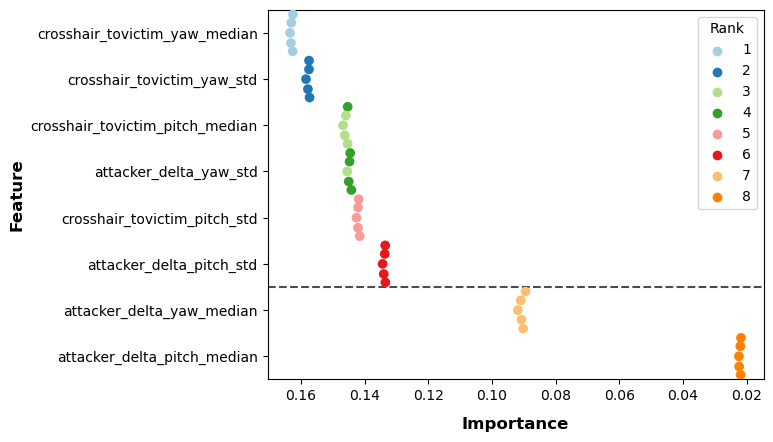

In [413]:
sns.swarmplot(x='importance', y='feature', data=cv_engagement_df, order=cv_engagement_df.\
              groupby('feature')['importance'].median().sort_values(ascending=False).index, \
              hue=cv_engagement_df['rank'].astype(int), size=7, palette="Paired")

plt.xlabel('Importance', fontweight="bold", labelpad=10, fontsize=12)
plt.ylabel('Feature', fontweight="bold", fontsize=12)
plt.axhline(y=5.5, color='k', linestyle='--', alpha=0.7)
plt.gca().invert_xaxis()
plt.legend(title="Rank")


### Player subset

In [414]:
X = df_player_subset.drop(["firing", "cheater"], axis=1)
y = df_player_subset.cheater
cv_player_df = cv_feature_importance(X, y, 5)

In [415]:
cv_player_df

,fold_num,feature,importance
0,0,attacker_delta_pitch_median_std,0.085473
1,0,attacker_delta_yaw_std_std,0.078671
2,0,crosshair_tovictim_pitch_median_median,0.076558
3,0,crosshair_tovictim_pitch_std_std,0.075086
4,0,crosshair_tovictim_yaw_median_std,0.073689
...,...,...,...
75,4,attacker_delta_yaw_std_median,0.063991
76,4,attacker_delta_pitch_std_std,0.061999
77,4,attacker_delta_pitch_std_median,0.061495
78,4,attacker_delta_yaw_median_median,0.005124


In [416]:
cv_player_df["rank"] = cv_player_df.groupby("fold_num")["importance"].rank("max", ascending=False)

In [417]:
cv_player_df

,fold_num,feature,importance,rank
0,0,attacker_delta_pitch_median_std,0.085473,1.0
1,0,attacker_delta_yaw_std_std,0.078671,2.0
2,0,crosshair_tovictim_pitch_median_median,0.076558,3.0
3,0,crosshair_tovictim_pitch_std_std,0.075086,4.0
4,0,crosshair_tovictim_yaw_median_std,0.073689,5.0
...,...,...,...,...
75,4,attacker_delta_yaw_std_median,0.063991,12.0
76,4,attacker_delta_pitch_std_std,0.061999,13.0
77,4,attacker_delta_pitch_std_median,0.061495,14.0
78,4,attacker_delta_yaw_median_median,0.005124,15.0


/Users/asadm2/opt/anaconda3/lib/python3.7/site-packages/seaborn/categorical.py:3544: UserWarning: 20.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/Users/asadm2/opt/anaconda3/lib/python3.7/site-packages/seaborn/categorical.py:3544: UserWarning: 40.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


/Users/asadm2/opt/anaconda3/lib/python3.7/site-packages/seaborn/categorical.py:3544: UserWarning: 20.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/Users/asadm2/opt/anaconda3/lib/python3.7/site-packages/seaborn/categorical.py:3544: UserWarning: 40.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


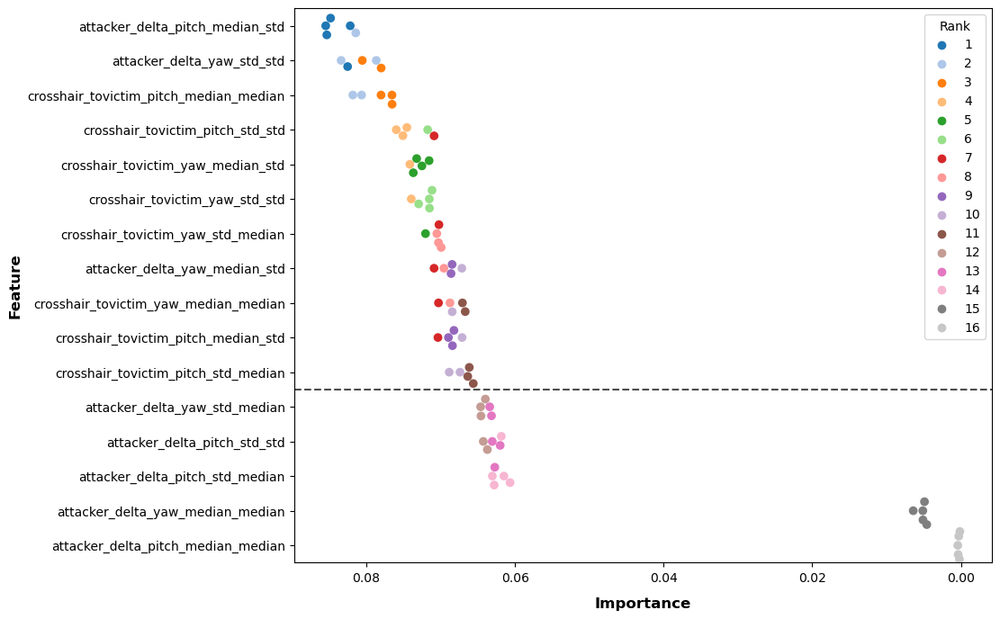

In [418]:
plt.figure(figsize=(10, 8))  # Increased height from 6 to 15
sns.swarmplot(x='importance', y='feature', data=cv_player_df, order=cv_player_df.\
              groupby('feature')['importance'].median().sort_values(ascending=False).index, \
              hue=cv_player_df['rank'].astype(int), size=7, palette="tab20")

plt.xlabel('Importance', fontweight="bold", labelpad=10, fontsize=12)
plt.ylabel('Feature', fontweight="bold", fontsize=12)
plt.axhline(y=10.5, color='k', linestyle='--', alpha=0.7)
plt.gca().invert_xaxis()
plt.legend(title='Rank')

### Get top K features corresponding to cumulative importance threshold of 80%

In [419]:
def get_cumu_features(df, threshold):
    total = 0
    for idx, val in enumerate(df.importance):
        if total > threshold:
            break
        total+=val
    return idx, total # return the idx of the feature just after the threshold was exceeded

topK_player = get_cumu_features(cv_player_df.loc[cv_player_df.fold_num == 0], 0.80)
topK_engagement = get_cumu_features(cv_engagement_df.loc[cv_engagement_df.fold_num == 0], 0.80)

In [420]:
topK_player

(11, 0.8063898597915178)

In [422]:
top_player_features = cv_player_df['feature'][:topK_player[0]]
top_player_features # even though these are from fold 0, the subset matches the one determined from the plot

0            attacker_delta_pitch_median_std
1                 attacker_delta_yaw_std_std
2     crosshair_tovictim_pitch_median_median
3           crosshair_tovictim_pitch_std_std
4          crosshair_tovictim_yaw_median_std
5             crosshair_tovictim_yaw_std_std
6              attacker_delta_yaw_median_std
7          crosshair_tovictim_yaw_std_median
8        crosshair_tovictim_pitch_median_std
9        crosshair_tovictim_pitch_std_median
10      crosshair_tovictim_yaw_median_median
Name: feature, dtype: object

In [423]:
topK_engagement

(6, 0.8866572972268872)

In [424]:
# even though these are from fold 0, the subset matches the one determined from the plot
top_engagement_features = cv_engagement_df['feature'][:topK_engagement[0]] 
top_engagement_features

0      crosshair_tovictim_yaw_median
1         crosshair_tovictim_yaw_std
2    crosshair_tovictim_pitch_median
3             attacker_delta_yaw_std
4       crosshair_tovictim_pitch_std
5           attacker_delta_pitch_std
Name: feature, dtype: object

### Model 1 : engagement level data with top 6 features

In [19]:
smote = False # toggle T/F

In [243]:
X = df_engagement_subset.loc[:,df_engagement_subset.columns.isin(top_engagement_features)]
y = df_engagement_subset.cheater

In [196]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=31, stratify=y) 
rf_model_engagement = RandomForestClassifier(random_state=31)

In [233]:
if smote:
    sm = SMOTE(random_state=31)
    X_train_resampled, y_train_resampled = sm.fit_resample(X_train, y_train)
    rf_model_engagement.fit(X_train_resampled, y_train_resampled)
else:
    rf_model_engagement.fit(X_train, y_train) 

In [234]:
y_pred = rf_model_engagement.predict(X_test)

In [199]:
from sklearn.metrics import auc, confusion_matrix, ConfusionMatrixDisplay, RocCurveDisplay, f1_score

In [200]:
f1_score(y_test, y_pred) # by default, returns the f1 score of the positive class #WITH SMOTE

0.6028091755319149

In [201]:
print(classification_report(y_test, y_pred, target_names=["not cheater", "cheater"])) #WITH SMOTE

              precision    recall  f1-score   support

 not cheater       0.92      0.92      0.92     60000
     cheater       0.60      0.60      0.60     12000

    accuracy                           0.87     72000
   macro avg       0.76      0.76      0.76     72000
weighted avg       0.87      0.87      0.87     72000



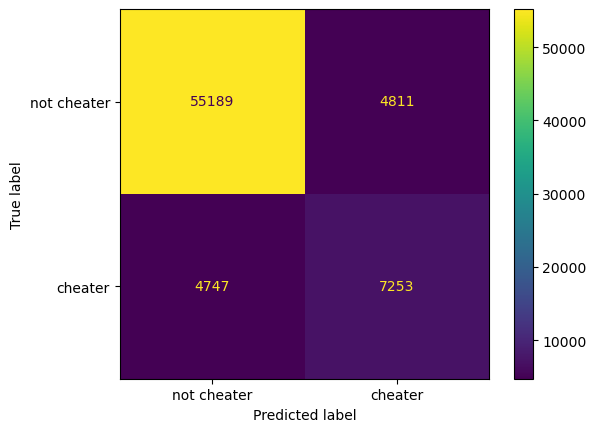

In [202]:
#WITH SMOTE
cm = confusion_matrix(y_test, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=["not cheater", "cheater"])
disp.plot()

In [207]:
print(classification_report(y_test, y_pred, target_names=["not cheater", "cheater"])) #WITHOUT SMOTE

              precision    recall  f1-score   support

 not cheater       0.87      1.00      0.93     60000
     cheater       0.97      0.25      0.40     12000

    accuracy                           0.87     72000
   macro avg       0.92      0.62      0.66     72000
weighted avg       0.89      0.87      0.84     72000



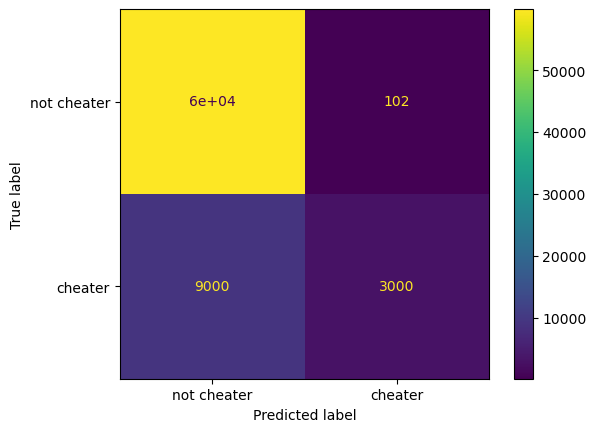

In [208]:
#WITHOUT SMOTE
cm = confusion_matrix(y_test, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=["not cheater", "cheater"])
disp.plot()

In [232]:
# experimenting with different seed (without smote)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=129, stratify=y) 
rf_model_engagement = RandomForestClassifier(random_state=129)

In [235]:
print(classification_report(y_test, y_pred, target_names=["not cheater", "cheater"])) #WITHOUT SMOTE

              precision    recall  f1-score   support

 not cheater       0.87      1.00      0.93     60000
     cheater       0.96      0.25      0.40     12000

    accuracy                           0.87     72000
   macro avg       0.92      0.63      0.66     72000
weighted avg       0.89      0.87      0.84     72000



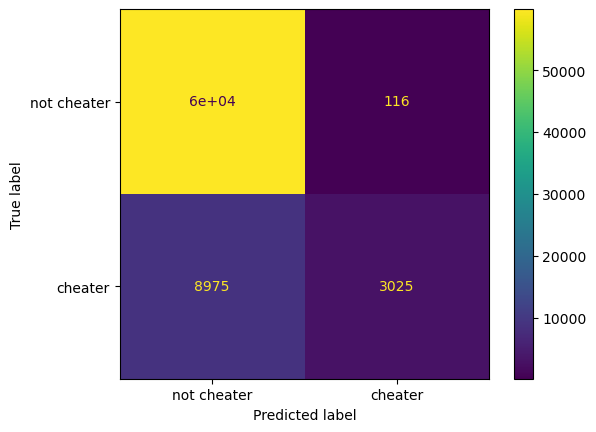

In [236]:
#WITHOUT SMOTE
cm = confusion_matrix(y_test, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=["not cheater", "cheater"])
disp.plot()

### Same model but now using stratified 5-fold CV (experimenting with and without SMOTE)

CV fold #1
Random Forest classification report:
{'not cheater': {'precision': 0.8337207845539207, 'recall': 0.9982, 'f1-score': 0.9085764997686537, 'support': 60000}, 'cheater': {'precision': 0.3374233128834356, 'recall': 0.004583333333333333, 'f1-score': 0.009043821425635123, 'support': 12000}, 'accuracy': 0.8325972222222222, 'macro avg': {'precision': 0.5855720487186782, 'recall': 0.5013916666666667, 'f1-score': 0.4588101605971444, 'support': 72000}, 'weighted avg': {'precision': 0.7510045392755065, 'recall': 0.8325972222222222, 'f1-score': 0.7586543867114839, 'support': 72000}}
CV fold #2
Random Forest classification report:
{'not cheater': {'precision': 0.8332869390936422, 'recall': 0.9978333333333333, 'f1-score': 0.908166980158971, 'support': 60000}, 'cheater': {'precision': 0.14473684210526316, 'recall': 0.0018333333333333333, 'f1-score': 0.003620803159973667, 'support': 12000}, 'accuracy': 0.8318333333333333, 'macro avg': {'precision': 0.48901189059945266, 'recall': 0.4998333333

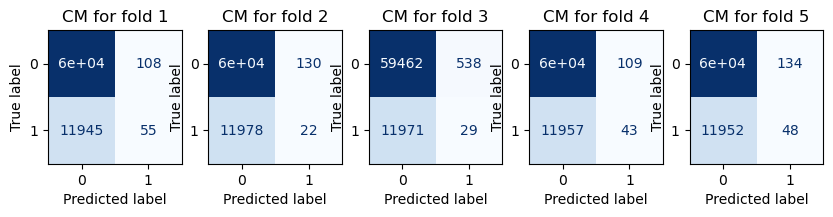

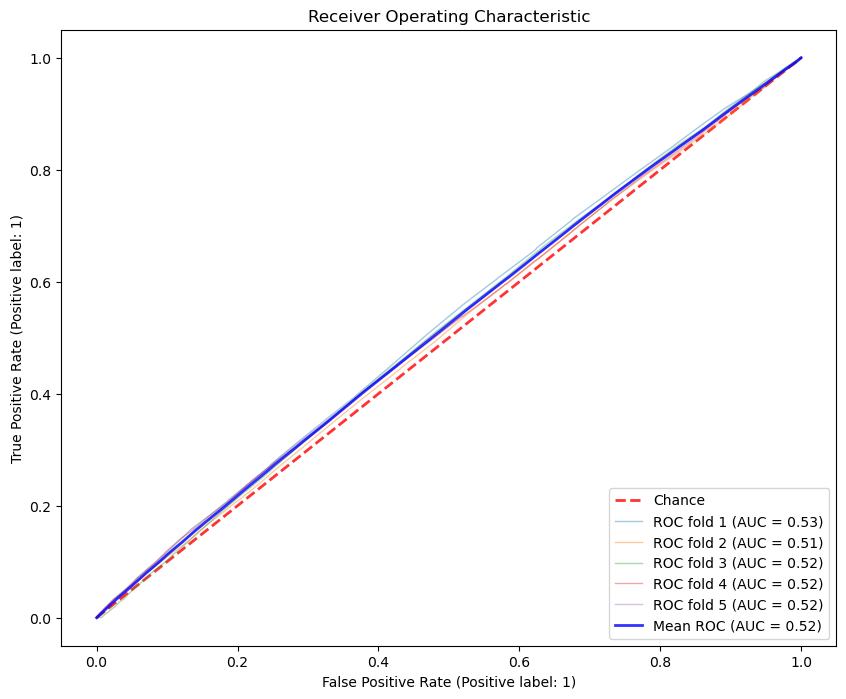

In [275]:
#WITHOUT SMOTE
fig_cm, ax_cm = plt.subplots(1,5,figsize=(10,8))

fig, ax = plt.subplots(figsize=(10,8))
ax.set(
    xlim=[-0.05, 1.05],
    ylim=[-0.05, 1.05],
    title="Receiver Operating Characteristic",
)

tprs = []
aucs = []
mean_fpr = np.linspace(0, 1, 100)

precision_cheater = []
precision_not_cheater = []
recall_cheater = []
recall_not_cheater = []
f1_cheater = []
f1_not_cheater = []

tn_arr, fp_arr, fn_arr, tp_arr = [], [], [], []

# random chance line
ax.plot([0, 1], [0, 1], linestyle="--", lw=2, color="r", label="Chance", alpha=0.8)


cv = StratifiedKFold(n_splits=5)

# actually perform the CV and loop through each fold
for fold_num, (train_idx, test_idx) in enumerate(cv.split(X,y)):
    print('=====================================================')
    print(f"CV fold #{fold_num+1}")
    print('=====================================================')
    
    # fit classifier **on this folds data**
    classifier1 = RandomForestClassifier()
    classifier1.fit(X.iloc[train_idx],y.iloc[train_idx])
    
    # predict on this folds "testing" set
    y_pred = classifier1.predict(X.iloc[test_idx])

    # get this fold's confusion matrix
    cm = confusion_matrix(y.iloc[test_idx], y_pred)
    
    # display it on the subplot figure
    disp = ConfusionMatrixDisplay(confusion_matrix=cm)
    disp.plot(ax=ax_cm.flatten()[fold_num], colorbar=False, cmap="Blues",)
    ax_cm.flatten()[fold_num].set(title=f'CM for fold {fold_num+1}')

    # print this folds classification report
    print('Random Forest classification report:')
    report = classification_report(y.iloc[test_idx], y_pred, target_names=["not cheater", "cheater"], \
                                   output_dict=True)
    print(report)

    precision_not_cheater.append(report["not cheater"]["precision"])
    precision_cheater.append(report["cheater"]["precision"])
    recall_not_cheater.append(report["not cheater"]["recall"])
    recall_cheater.append(report["cheater"]["recall"])
    f1_not_cheater.append(report["not cheater"]["f1-score"])
    f1_cheater.append(report["cheater"]["f1-score"])
    
    tn, fp, fn, tp = cm.ravel()
    tn_arr.append(tn)
    fp_arr.append(fp)
    fn_arr.append(fn)
    tp_arr.append(tp)
    
    # build and display ROC curve for this fold
    viz = RocCurveDisplay.from_estimator(
        classifier1,
        X.iloc[test_idx],
        y.iloc[test_idx],
        name=f"ROC fold {fold_num+1}",
        alpha=0.4,
        lw=1,
        ax=ax,
    )

    # store information for the mean curve
    interp_tpr = np.interp(mean_fpr, viz.fpr, viz.tpr)
    interp_tpr[0] = 0.0
    tprs.append(interp_tpr)
    aucs.append(viz.roc_auc)

# now actually plot MEAN ROC curve
mean_tpr = np.mean(tprs, axis=0)
mean_tpr[-1] = 1.0
mean_auc = auc(mean_fpr, mean_tpr)
std_auc = np.std(aucs)
ax.plot(
    mean_fpr,
    mean_tpr,
    color="b",
    label=f"Mean ROC (AUC = {mean_auc:0.2f})",
    lw=2,
    alpha=0.8,
)

ax.legend(loc="lower right");

In [276]:
# class: not cheater 
# median precision and std
print("Precision: ", np.mean(precision_not_cheater), np.std(precision_not_cheater))
# median recall and std
print("Recall: ", np.mean(recall_not_cheater), np.std(recall_not_cheater))
# median f1-score and std
print("F1: ", np.mean(f1_not_cheater), np.std(f1_not_cheater))

Precision:  0.8333165324304697 0.000471724082019259
Recall:  0.9966033333333334 0.0027905873535472407
F1:  0.9076736037475227 0.0014307565045753921


In [277]:
# class: cheater 
# median precision and std
print("Precision: ", np.mean(precision_cheater), np.std(precision_cheater))
# median recall and std
print("Recall: ", np.mean(recall_cheater), np.std(recall_cheater))
# median f1-score and std
print("F1: ", np.mean(f1_cheater), np.std(f1_cheaterheater))

Precision:  0.2159875080093571 0.10368454952137411
Recall:  0.0032833333333333334 0.0010146154170149616
F1:  0.006447478106841159 0.0020267178496270835


<Figure size 800x600 with 0 Axes>

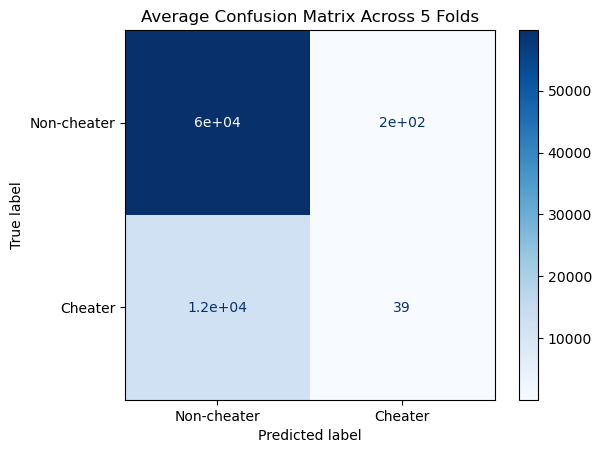

In [278]:
# average confusion matrix
avg_tn = np.mean(tn_arr)
avg_tp = np.mean(tp_arr)
avg_fn = np.mean(fn_arr)
avg_fp = np.mean(fp_arr)

avg_cm = np.array([[avg_tn, avg_fp],
                   [avg_fn, avg_tp]])

# Create the display
cmd = ConfusionMatrixDisplay(confusion_matrix=avg_cm, display_labels=['Non-cheater', 'Cheater'])

# Plot
plt.figure(figsize=(8, 6))
cmd.plot(cmap='Blues')
plt.title('Average Confusion Matrix Across 5 Folds')

# Show plot
plt.show()

CV fold #1
Random Forest classification report:
{'not cheater': {'precision': 0.8367902133042228, 'recall': 0.8048666666666666, 'f1-score': 0.8205180484406724, 'support': 60000}, 'cheater': {'precision': 0.1806284554552453, 'recall': 0.21508333333333332, 'f1-score': 0.19635589029632167, 'support': 12000}, 'accuracy': 0.7065694444444445, 'macro avg': {'precision': 0.508709334379734, 'recall': 0.509975, 'f1-score': 0.508436969368497, 'support': 72000}, 'weighted avg': {'precision': 0.7274299203293932, 'recall': 0.7065694444444445, 'f1-score': 0.7164910220832805, 'support': 72000}}
CV fold #2
Random Forest classification report:
{'not cheater': {'precision': 0.8341611527458448, 'recall': 0.7921333333333334, 'f1-score': 0.8126041871479008, 'support': 60000}, 'cheater': {'precision': 0.1698062970112494, 'recall': 0.21258333333333335, 'f1-score': 0.18880213151759614, 'support': 12000}, 'accuracy': 0.6955416666666666, 'macro avg': {'precision': 0.5019837248785471, 'recall': 0.5023583333333334

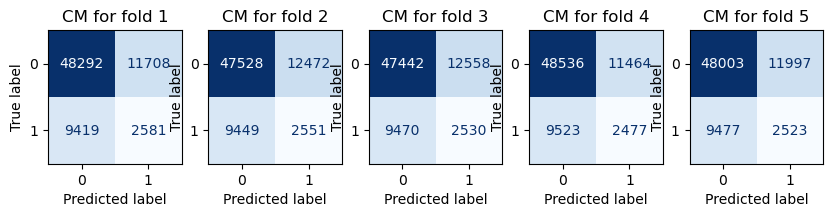

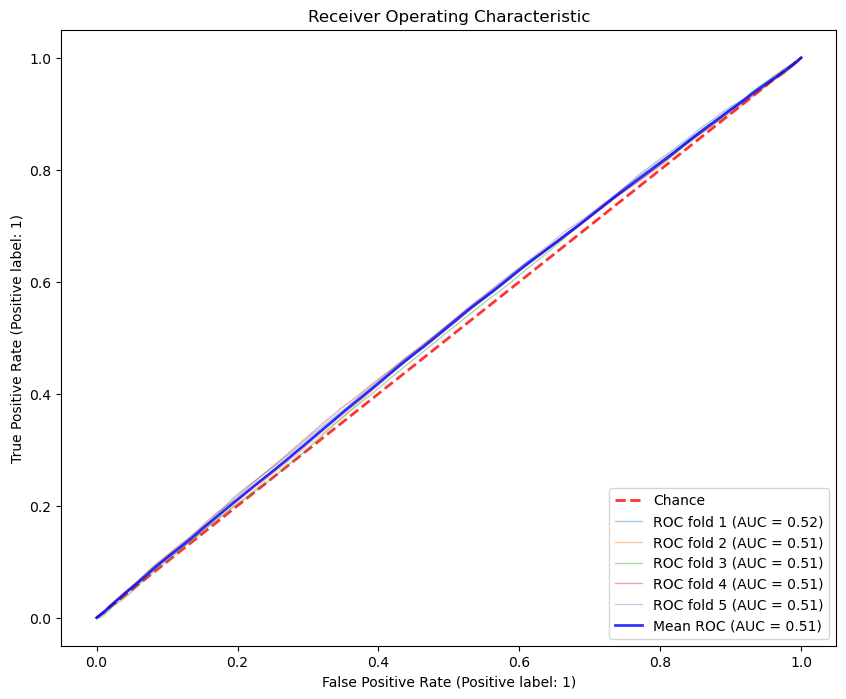

In [279]:
#WITH SMOTE
fig_cm, ax_cm = plt.subplots(1,5,figsize=(10,8))

# setup ROC figure
fig, ax = plt.subplots(figsize=(10,8))
ax.set(
    xlim=[-0.05, 1.05],
    ylim=[-0.05, 1.05],
    title="Receiver Operating Characteristic",
)

# setup mean curve variables
tprs = []
aucs = []
mean_fpr = np.linspace(0, 1, 100)

precision_cheater = []
precision_not_cheater = []
recall_cheater = []
recall_not_cheater = []
f1_cheater = []
f1_not_cheater = []

tn_arr, fp_arr, fn_arr, tp_arr = [], [], [], []

# plot random chance line
ax.plot([0, 1], [0, 1], linestyle="--", lw=2, color="r", label="Chance", alpha=0.8)


cv = StratifiedKFold(n_splits=5)

# actually perform the CV and loop through each fold
for fold_num, (train_idx, test_idx) in enumerate(cv.split(X,y)):
    print('=====================================================')
    print(f"CV fold #{fold_num+1}")
    print('=====================================================')
    
    X_train = X.iloc[train_idx]
    y_train = y.iloc[train_idx]
    X_test = X.iloc[test_idx]
    y_test = y.iloc[test_idx]
    
    sm = SMOTE(random_state=31)
    
    X_train_resampled, y_train_resampled = sm.fit_resample(X_train, y_train)
    
    # fit classifier **on this folds data**
    classifier1 = RandomForestClassifier()
    classifier1.fit(X_train_resampled, y_train_resampled)
    
    # predict on this folds "testing" set
    y_pred = classifier1.predict(X_test)

    # get this fold's confusion matrix
    cm = confusion_matrix(y_test, y_pred)
    
    # display it on the subplot figure
    disp = ConfusionMatrixDisplay(confusion_matrix=cm)
    disp.plot(ax=ax_cm.flatten()[fold_num], colorbar=False, cmap="Blues")
    ax_cm.flatten()[fold_num].set(title=f'CM for fold {fold_num+1}')

    # print this folds classification report
    print('Random Forest classification report:')
    report = classification_report(y.iloc[test_idx], y_pred, target_names=["not cheater", "cheater"], \
                                   output_dict=True)
    print(report)

    precision_not_cheater.append(report["not cheater"]["precision"])
    precision_cheater.append(report["cheater"]["precision"])
    recall_not_cheater.append(report["not cheater"]["recall"])
    recall_cheater.append(report["cheater"]["recall"])
    f1_not_cheater.append(report["not cheater"]["f1-score"])
    f1_cheater.append(report["cheater"]["f1-score"])
    
    tn, fp, fn, tp = cm.ravel()
    tn_arr.append(tn)
    fp_arr.append(fp)
    fn_arr.append(fn)
    tp_arr.append(tp)

    # build and display ROC curve for this fold
    viz = RocCurveDisplay.from_estimator(
        classifier1,
        X_test,
        y_test,
        name=f"ROC fold {fold_num+1}",
        alpha=0.4,
        lw=1,
        ax=ax,
    )

    # store information for the mean curve
    interp_tpr = np.interp(mean_fpr, viz.fpr, viz.tpr)
    interp_tpr[0] = 0.0
    tprs.append(interp_tpr)
    aucs.append(viz.roc_auc)

# now actually plot MEAN ROC curve
mean_tpr = np.mean(tprs, axis=0)
mean_tpr[-1] = 1.0
mean_auc = auc(mean_fpr, mean_tpr)
std_auc = np.std(aucs)
ax.plot(
    mean_fpr,
    mean_tpr,
    color="b",
    label=f"Mean ROC (AUC = {mean_auc:0.2f})",
    lw=2,
    alpha=0.8,
)

ax.legend(loc="lower right");

In [280]:
# class: not cheater 
# median precision and std
print("Precision: ", np.mean(precision_not_cheater), np.std(precision_not_cheater))
# median recall and std
print("Recall: ", np.mean(recall_not_cheater), np.std(recall_not_cheater))
# median f1-score and std
print("F1: ", np.mean(f1_not_cheater), np.std(f1_not_cheater))

Precision:  0.835131315550498 0.0011614821838633693
Recall:  0.7993366666666666 0.0070663396150733755
F1:  0.8168302817741667 0.00420259181094247


In [282]:
# class: cheater 
# median precision and std
print("Precision: ", np.mean(precision_cheater), np.std(precision_cheater))
# median recall and std
print("Recall: ", np.mean(recall_cheater), np.std(recall_cheater))
# median f1-score and std
print("F1: ", np.mean(f1_cheater), np.std(f1_cheater))

Precision:  0.173911072887989 0.004795202139668344
Recall:  0.21103333333333332 0.0028555987891236466
F1:  0.19063998361893583 0.0031953576900967755


<Figure size 800x600 with 0 Axes>

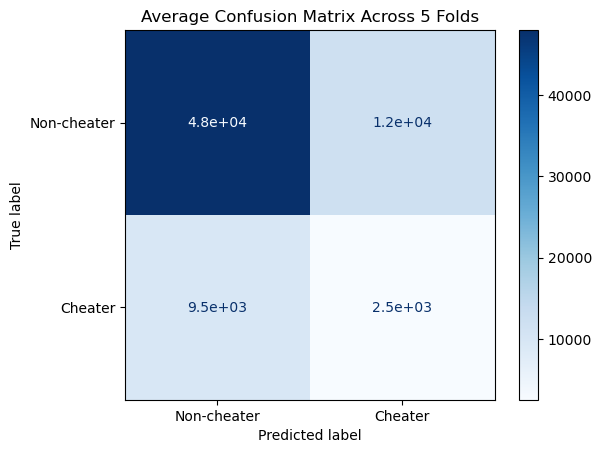

In [283]:
# average confusion matrix
avg_tn = np.mean(tn_arr)
avg_tp = np.mean(tp_arr)
avg_fn = np.mean(fn_arr)
avg_fp = np.mean(fp_arr)

avg_cm = np.array([[avg_tn, avg_fp],
                   [avg_fn, avg_tp]])

# Create the display
cmd = ConfusionMatrixDisplay(confusion_matrix=avg_cm, display_labels=['Non-cheater', 'Cheater'])

# Plot
plt.figure(figsize=(8, 6))
cmd.plot(cmap='Blues')
plt.title('Average Confusion Matrix Across 5 Folds')

# Show plot
plt.show()

### Model 2 : player level data with top 11 features

In [291]:
smote = False

In [297]:
X = df_player_subset.loc[:,df_player_subset.columns.isin(top_player_features)]
y = df_player_subset.cheater

In [286]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=31, stratify=y) 
rf_model_player = RandomForestClassifier(random_state=31)

In [293]:
if smote:
    sm = SMOTE(random_state=31)
    X_train_resampled, y_train_resampled = sm.fit_resample(X_train, y_train)
    rf_model_player.fit(X_train_resampled, y_train_resampled)
else:
    rf_model_player.fit(X_train, y_train) 

In [294]:
y_pred = rf_model_player.predict(X_test)

In [295]:
print(classification_report(y_test, y_pred, target_names=["not cheater", "cheater"])) #WITHOUT SMOTE

              precision    recall  f1-score   support

 not cheater       0.83      1.00      0.91      2000
     cheater       0.14      0.00      0.00       400

    accuracy                           0.83      2400
   macro avg       0.49      0.50      0.46      2400
weighted avg       0.72      0.83      0.76      2400



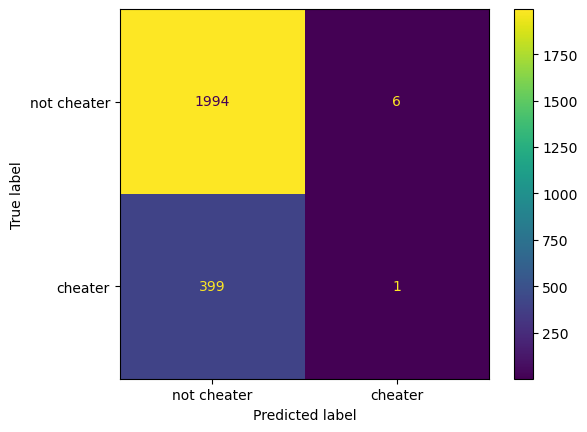

In [296]:
#WITHOUT SMOTE
cm = confusion_matrix(y_test, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=["not cheater", "cheater"])
disp.plot()

In [289]:
print(classification_report(y_test, y_pred, target_names=["not cheater", "cheater"])) #WITH SMOTE

              precision    recall  f1-score   support

 not cheater       0.84      0.84      0.84      2000
     cheater       0.18      0.17      0.17       400

    accuracy                           0.73      2400
   macro avg       0.51      0.51      0.51      2400
weighted avg       0.73      0.73      0.73      2400



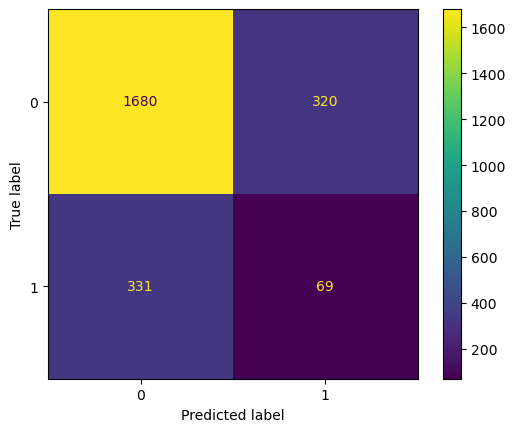

In [290]:
#WITH SMOTE
cm = confusion_matrix(y_test, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()

### Same model but now using stratified 5-fold CV (experimenting with and without SMOTE)

CV fold #1
Random Forest classification report:
{'not cheater': {'precision': 0.833889816360601, 'recall': 0.999, 'f1-score': 0.9090081892629663, 'support': 2000}, 'cheater': {'precision': 0.5, 'recall': 0.005, 'f1-score': 0.009900990099009901, 'support': 400}, 'accuracy': 0.8333333333333334, 'macro avg': {'precision': 0.6669449081803005, 'recall': 0.502, 'f1-score': 0.4594545896809881, 'support': 2400}, 'weighted avg': {'precision': 0.7782415136338342, 'recall': 0.8333333333333334, 'f1-score': 0.7591569894023069, 'support': 2400}}
CV fold #2
Random Forest classification report:
{'not cheater': {'precision': 0.8342402678945166, 'recall': 0.9965, 'f1-score': 0.9081795397584872, 'support': 2000}, 'cheater': {'precision': 0.36363636363636365, 'recall': 0.01, 'f1-score': 0.019464720194647202, 'support': 400}, 'accuracy': 0.8320833333333333, 'macro avg': {'precision': 0.5989383157654401, 'recall': 0.50325, 'f1-score': 0.4638221299765672, 'support': 2400}, 'weighted avg': {'precision': 0.755

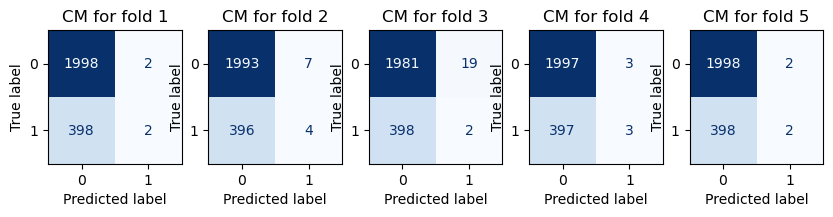

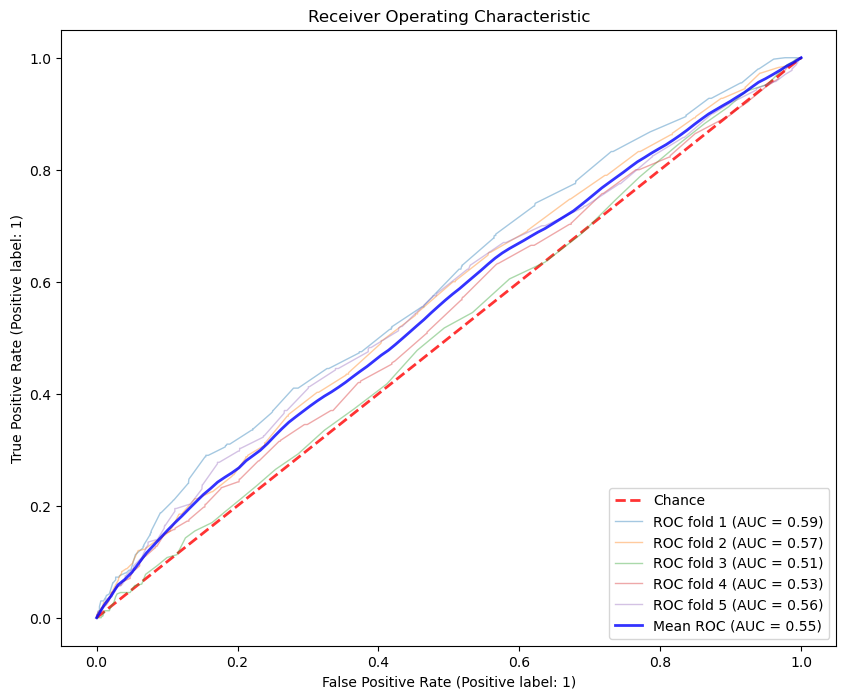

In [298]:
#WITHOUT SMOTE
fig_cm, ax_cm = plt.subplots(1,5,figsize=(10,8))

fig, ax = plt.subplots(figsize=(10,8))
ax.set(
    xlim=[-0.05, 1.05],
    ylim=[-0.05, 1.05],
    title="Receiver Operating Characteristic",
)

tprs = []
aucs = []
mean_fpr = np.linspace(0, 1, 100)

precision_cheater = []
precision_not_cheater = []
recall_cheater = []
recall_not_cheater = []
f1_cheater = []
f1_not_cheater = []

tn_arr, fp_arr, fn_arr, tp_arr = [], [], [], []

# random chance line
ax.plot([0, 1], [0, 1], linestyle="--", lw=2, color="r", label="Chance", alpha=0.8)


cv = StratifiedKFold(n_splits=5)

# actually perform the CV and loop through each fold
for fold_num, (train_idx, test_idx) in enumerate(cv.split(X,y)):
    print('=====================================================')
    print(f"CV fold #{fold_num+1}")
    print('=====================================================')
    
    # fit classifier **on this folds data**
    classifier1 = RandomForestClassifier()
    classifier1.fit(X.iloc[train_idx],y.iloc[train_idx])
    
    # predict on this folds "testing" set
    y_pred = classifier1.predict(X.iloc[test_idx])

    # get this fold's confusion matrix
    cm = confusion_matrix(y.iloc[test_idx], y_pred)
    
    # display it on the subplot figure
    disp = ConfusionMatrixDisplay(confusion_matrix=cm)
    disp.plot(ax=ax_cm.flatten()[fold_num], colorbar=False, cmap="Blues",)
    ax_cm.flatten()[fold_num].set(title=f'CM for fold {fold_num+1}')

    # print this folds classification report
    print('Random Forest classification report:')
    report = classification_report(y.iloc[test_idx], y_pred, target_names=["not cheater", "cheater"], \
                                   output_dict=True)
    print(report)

    precision_not_cheater.append(report["not cheater"]["precision"])
    precision_cheater.append(report["cheater"]["precision"])
    recall_not_cheater.append(report["not cheater"]["recall"])
    recall_cheater.append(report["cheater"]["recall"])
    f1_not_cheater.append(report["not cheater"]["f1-score"])
    f1_cheater.append(report["cheater"]["f1-score"])
    
    tn, fp, fn, tp = cm.ravel()
    tn_arr.append(tn)
    fp_arr.append(fp)
    fn_arr.append(fn)
    tp_arr.append(tp)
    
    # build and display ROC curve for this fold
    viz = RocCurveDisplay.from_estimator(
        classifier1,
        X.iloc[test_idx],
        y.iloc[test_idx],
        name=f"ROC fold {fold_num+1}",
        alpha=0.4,
        lw=1,
        ax=ax,
    )

    # store information for the mean curve
    interp_tpr = np.interp(mean_fpr, viz.fpr, viz.tpr)
    interp_tpr[0] = 0.0
    tprs.append(interp_tpr)
    aucs.append(viz.roc_auc)

# now actually plot MEAN ROC curve
mean_tpr = np.mean(tprs, axis=0)
mean_tpr[-1] = 1.0
mean_auc = auc(mean_fpr, mean_tpr)
std_auc = np.std(aucs)
ax.plot(
    mean_fpr,
    mean_tpr,
    color="b",
    label=f"Mean ROC (AUC = {mean_auc:0.2f})",
    lw=2,
    alpha=0.8,
)

ax.legend(loc="lower right");

In [299]:
# class: not cheater 
# median precision and std
print("Precision: ", np.mean(precision_not_cheater), np.std(precision_not_cheater))
# median recall and std
print("Recall: ", np.mean(recall_not_cheater), np.std(recall_not_cheater))
# median f1-score and std
print("F1: ", np.mean(f1_not_cheater), np.std(f1_not_cheater))

Precision:  0.8337782944292957 0.0005563104495663608
Recall:  0.9967 0.003234192325759233
F1:  0.907987094065969 0.001637919225082117


In [301]:
# class: cheater 
# median precision and std
print("Precision: ", np.mean(precision_cheater), np.std(precision_cheater))
# median recall and std
print("Recall: ", np.mean(recall_cheater), np.std(recall_cheater))
# median f1-score and std
print("F1: ", np.mean(f1_cheater), np.std(f1_cheater))

Precision:  0.3917748917748918 0.1573936914981775
Recall:  0.006500000000000001 0.002
F1:  0.012709242632855156 0.003898249884503461


In [311]:
# average accuracy and std
accuracy_arr = [0.8333333333333334, 0.8320833333333333, 0.82625, 0.8333333333333334, 0.8333333333333334]
print(np.mean(accuracy_arr), np.std(accuracy_arr))


0.8316666666666667 0.0027512623365365256


<Figure size 800x600 with 0 Axes>

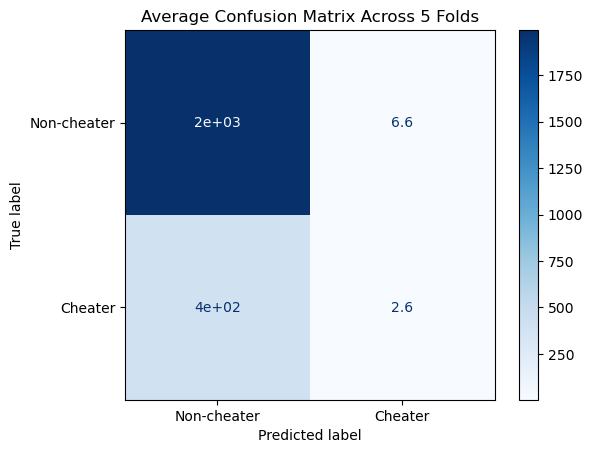

In [302]:
# average confusion matrix
avg_tn = np.mean(tn_arr)
avg_tp = np.mean(tp_arr)
avg_fn = np.mean(fn_arr)
avg_fp = np.mean(fp_arr)

avg_cm = np.array([[avg_tn, avg_fp],
                   [avg_fn, avg_tp]])

# Create the display
cmd = ConfusionMatrixDisplay(confusion_matrix=avg_cm, display_labels=['Non-cheater', 'Cheater'])

# Plot
plt.figure(figsize=(8, 6))
cmd.plot(cmap='Blues')
plt.title('Average Confusion Matrix Across 5 Folds')

# Show plot
plt.show()

CV fold #1
Random Forest classification report:
{'not cheater': {'precision': 0.8390219052470708, 'recall': 0.8235, 'f1-score': 0.8311884935654807, 'support': 2000}, 'cheater': {'precision': 0.19221967963386727, 'recall': 0.21, 'f1-score': 0.20071684587813618, 'support': 400}, 'accuracy': 0.72125, 'macro avg': {'precision': 0.515620792440469, 'recall': 0.51675, 'f1-score': 0.5159526697218084, 'support': 2400}, 'weighted avg': {'precision': 0.7312215343115368, 'recall': 0.72125, 'f1-score': 0.7261098856175899, 'support': 2400}}
CV fold #2
Random Forest classification report:
{'not cheater': {'precision': 0.8324873096446701, 'recall': 0.82, 'f1-score': 0.8261964735516373, 'support': 2000}, 'cheater': {'precision': 0.16279069767441862, 'recall': 0.175, 'f1-score': 0.16867469879518074, 'support': 400}, 'accuracy': 0.7125, 'macro avg': {'precision': 0.4976390036595444, 'recall': 0.49749999999999994, 'f1-score': 0.497435586173409, 'support': 2400}, 'weighted avg': {'precision': 0.72087120764

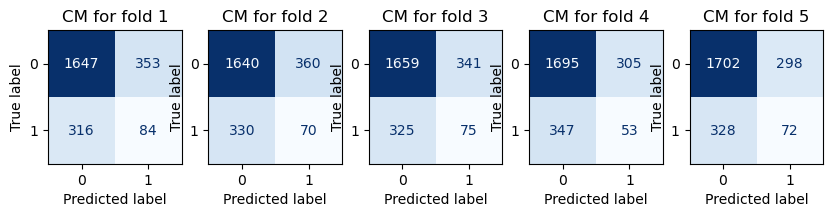

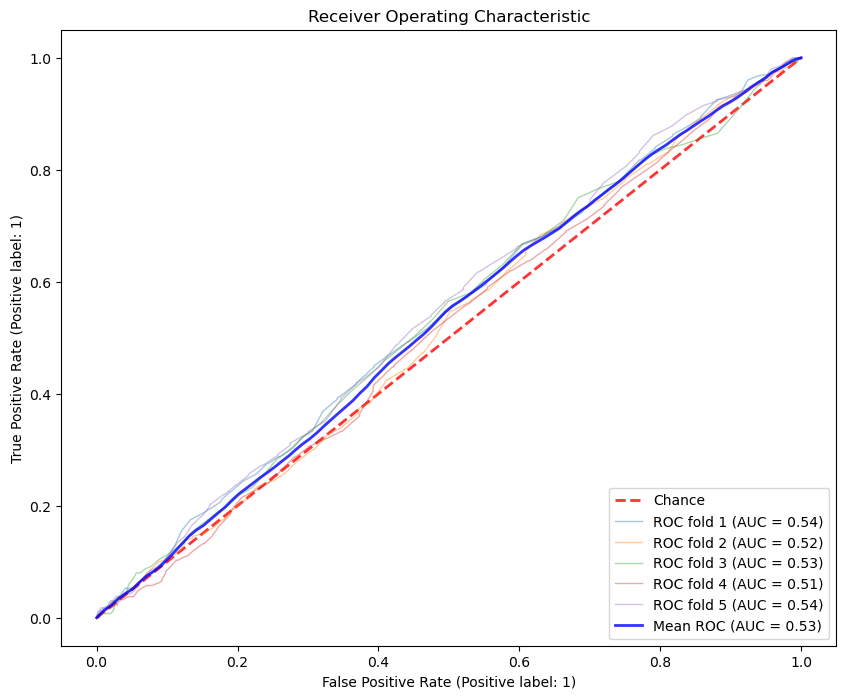

In [303]:
#WITH SMOTE
fig_cm, ax_cm = plt.subplots(1,5,figsize=(10,8))

# setup ROC figure
fig, ax = plt.subplots(figsize=(10,8))
ax.set(
    xlim=[-0.05, 1.05],
    ylim=[-0.05, 1.05],
    title="Receiver Operating Characteristic",
)

# setup mean curve variables
tprs = []
aucs = []
mean_fpr = np.linspace(0, 1, 100)

precision_cheater = []
precision_not_cheater = []
recall_cheater = []
recall_not_cheater = []
f1_cheater = []
f1_not_cheater = []

tn_arr, fp_arr, fn_arr, tp_arr = [], [], [], []

# plot random chance line
ax.plot([0, 1], [0, 1], linestyle="--", lw=2, color="r", label="Chance", alpha=0.8)


cv = StratifiedKFold(n_splits=5)

# actually perform the CV and loop through each fold
for fold_num, (train_idx, test_idx) in enumerate(cv.split(X,y)):
    print('=====================================================')
    print(f"CV fold #{fold_num+1}")
    print('=====================================================')
    
    X_train = X.iloc[train_idx]
    y_train = y.iloc[train_idx]
    X_test = X.iloc[test_idx]
    y_test = y.iloc[test_idx]
    
    sm = SMOTE(random_state=31)
    
    X_train_resampled, y_train_resampled = sm.fit_resample(X_train, y_train)
    
    # fit classifier **on this folds data**
    classifier1 = RandomForestClassifier()
    classifier1.fit(X_train_resampled, y_train_resampled)
    
    # predict on this folds "testing" set
    y_pred = classifier1.predict(X_test)

    # get this fold's confusion matrix
    cm = confusion_matrix(y_test, y_pred)
    
    # display it on the subplot figure
    disp = ConfusionMatrixDisplay(confusion_matrix=cm)
    disp.plot(ax=ax_cm.flatten()[fold_num], colorbar=False, cmap="Blues")
    ax_cm.flatten()[fold_num].set(title=f'CM for fold {fold_num+1}')

    # print this folds classification report
    print('Random Forest classification report:')
    report = classification_report(y.iloc[test_idx], y_pred, target_names=["not cheater", "cheater"], \
                                   output_dict=True)
    print(report)

    precision_not_cheater.append(report["not cheater"]["precision"])
    precision_cheater.append(report["cheater"]["precision"])
    recall_not_cheater.append(report["not cheater"]["recall"])
    recall_cheater.append(report["cheater"]["recall"])
    f1_not_cheater.append(report["not cheater"]["f1-score"])
    f1_cheater.append(report["cheater"]["f1-score"])
    
    tn, fp, fn, tp = cm.ravel()
    tn_arr.append(tn)
    fp_arr.append(fp)
    fn_arr.append(fn)
    tp_arr.append(tp)

    # build and display ROC curve for this fold
    viz = RocCurveDisplay.from_estimator(
        classifier1,
        X_test,
        y_test,
        name=f"ROC fold {fold_num+1}",
        alpha=0.4,
        lw=1,
        ax=ax,
    )

    # store information for the mean curve
    interp_tpr = np.interp(mean_fpr, viz.fpr, viz.tpr)
    interp_tpr[0] = 0.0
    tprs.append(interp_tpr)
    aucs.append(viz.roc_auc)

# now actually plot MEAN ROC curve
mean_tpr = np.mean(tprs, axis=0)
mean_tpr[-1] = 1.0
mean_auc = auc(mean_fpr, mean_tpr)
std_auc = np.std(aucs)
ax.plot(
    mean_fpr,
    mean_tpr,
    color="b",
    label=f"Mean ROC (AUC = {mean_auc:0.2f})",
    lw=2,
    alpha=0.8,
)

ax.legend(loc="lower right");

In [304]:
# class: not cheater 
# median precision and std
print("Precision: ", np.mean(precision_not_cheater), np.std(precision_not_cheater))
# median recall and std
print("Recall: ", np.mean(recall_not_cheater), np.std(recall_not_cheater))
# median f1-score and std
print("F1: ", np.mean(f1_not_cheater), np.std(f1_not_cheater))

Precision:  0.8352381873152067 0.003454303481383372
Recall:  0.8343 0.012627747225851499
F1:  0.8347150041614915 0.006377816219056236


In [305]:
# class: cheater 
# median precision and std
print("Precision: ", np.mean(precision_cheater), np.std(precision_cheater))
# median recall and std
print("Recall: ", np.mean(recall_cheater), np.std(recall_cheater))
# median f1-score and std
print("F1: ", np.mean(f1_cheater), np.std(f1_cheater))

Precision:  0.17558762523575444 0.017789673775940047
Recall:  0.177 0.02526855753698655
F1:  0.17601394995048442 0.020758123757569916


In [310]:
# average accuracy and std
accuracy_arr = [0.72125, 0.7125, 0.7225, 0.7283, 0.73916]
print(np.mean(accuracy_arr), np.std(accuracy_arr))


0.724742 0.008804831400997982


<Figure size 800x600 with 0 Axes>

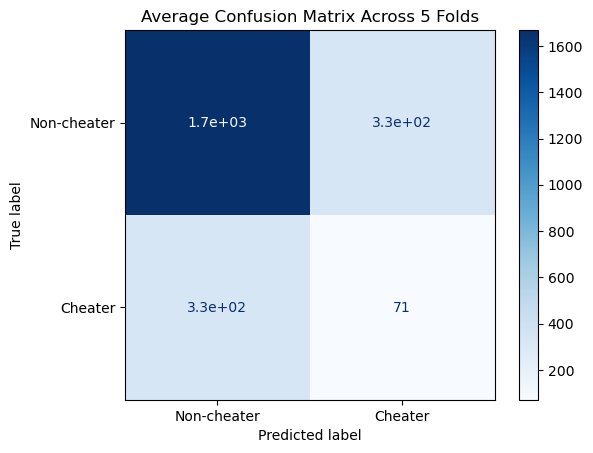

In [306]:
# average confusion matrix
avg_tn = np.mean(tn_arr)
avg_tp = np.mean(tp_arr)
avg_fn = np.mean(fn_arr)
avg_fp = np.mean(fp_arr)

avg_cm = np.array([[avg_tn, avg_fp],
                   [avg_fn, avg_tp]])

# Create the display
cmd = ConfusionMatrixDisplay(confusion_matrix=avg_cm, display_labels=['Non-cheater', 'Cheater'])

# Plot
plt.figure(figsize=(8, 6))
cmd.plot(cmap='Blues')
plt.title('Average Confusion Matrix Across 5 Folds')

# Show plot
plt.show()

## Attempt at Isolation Forest

In [354]:
from sklearn.ensemble import IsolationForest 
from sklearn.metrics import classification_report

### Engagement subset

In [355]:
X_iso_engagement = df_engagement_subset.loc[:,df_engagement_subset.columns.isin(top_engagement_features)]
y = df_engagement_subset.cheater

In [ ]:
# Training only on most important feature - didn't do well
# X_iso_engagement = df_engagement_subset[top_engagement_features[0]]
# X_iso_engagement = X_iso_engagement.values.reshape(-1,1)

In [356]:
# Split the data
X_train, X_test, y_train, y_test = train_test_split(X_iso_engagement, y, test_size=0.2, random_state=42, stratify=y)

In [357]:
# Initialize the Isolation Forest model
iso_forest = IsolationForest(contamination="auto", random_state=42)

# Fit the model to the data
iso_forest.fit(X_train)

IsolationForest(random_state=42)

In [385]:
idx_anomalies = [i for i in range(len(y_test)) if y_test.values[i] == 1]
idx_normal = [i for i in range(len(y_test)) if y_test.values[i] == 0]

In [386]:
anomaly_scores_cheaters = iso_forest.decision_function(X_test.iloc[idx_anomalies]) 
anomaly_scores_noncheaters = iso_forest.decision_function(X_test.iloc[idx_normal]) 

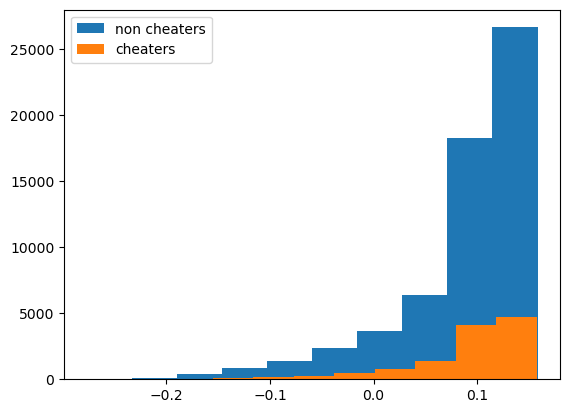

In [388]:
plt.hist(anomaly_scores_noncheaters, label="non cheaters")
plt.hist(anomaly_scores_cheaters, label="cheaters")
plt.legend()

In [389]:
y_pred = iso_forest.predict(X_test)

In [390]:
# Anomalies are labeled as -1, normal points as 1
y_pred = pd.Series(y_pred).map({1: 0, -1: 1})

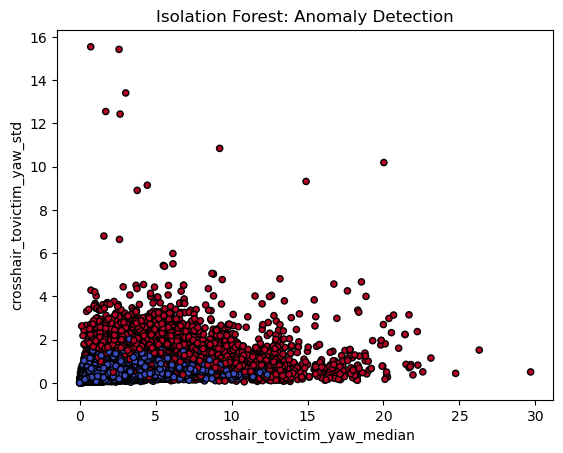

In [393]:
# Plot the data points and anomalies for top 2 features

plt.scatter(X_test.iloc[:,0], X_test.iloc[:,1], c=y_pred, \
            cmap='coolwarm', edgecolor='k', s=20)
plt.title('Isolation Forest: Anomaly Detection')
plt.xlabel(top_engagement_features[0])
plt.ylabel(top_engagement_features[1])
plt.show()

In [394]:
from sklearn.metrics import roc_auc_score

In [395]:
# Calculate AUC-ROC
auc_roc = roc_auc_score(y_test, -iso_forest.score_samples(X_test))
print(f"AUC-ROC: {auc_roc}")

AUC-ROC: 0.4924294090277778


### Player subset

In [396]:
X = df_player_subset.loc[:,df_player_subset.columns.isin(top_player_features)]
y = df_player_subset.cheater

In [397]:
# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

In [398]:
# Initialize the Isolation Forest model
iso_forest = IsolationForest(contamination="auto", random_state=42)

# Fit the model to the data
iso_forest.fit(X_train)

IsolationForest(random_state=42)

In [399]:
idx_anomalies = [i for i in range(len(y_test)) if y_test.values[i] == 1]
idx_normal = [i for i in range(len(y_test)) if y_test.values[i] == 0]

In [400]:
anomaly_scores_cheaters = iso_forest.decision_function(X_test.iloc[idx_anomalies]) 
anomaly_scores_noncheaters = iso_forest.decision_function(X_test.iloc[idx_normal]) 

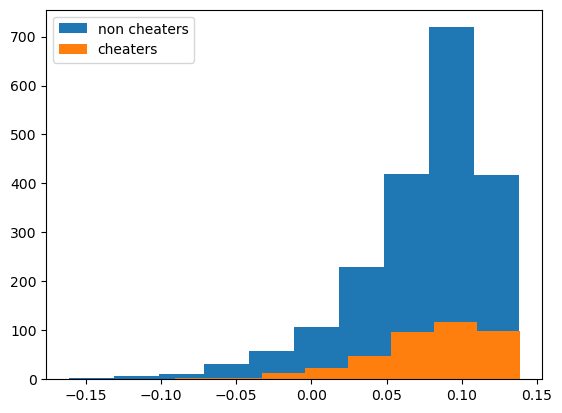

In [401]:
plt.hist(anomaly_scores_noncheaters, label="non cheaters")
plt.hist(anomaly_scores_cheaters, label="cheaters")
plt.legend()

In [402]:
y_pred = iso_forest.predict(X_test)

In [403]:
# Anomalies are labeled as -1, normal points as 1
y_pred = pd.Series(y_pred).map({1: 0, -1: 1})

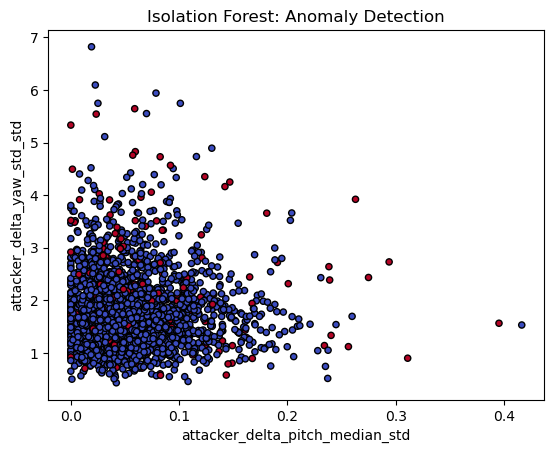

In [404]:
# Plot the data points and anomalies for top 2 features
plt.scatter(X_test.iloc[:,0], X_test.iloc[:,1], c=y_pred, \
            cmap='coolwarm', edgecolor='k', s=20)
plt.title('Isolation Forest: Anomaly Detection')
plt.xlabel(top_player_features[0])
plt.ylabel(top_player_features[1])
plt.show()

In [405]:
# Calculate AUC-ROC
auc_roc = roc_auc_score(y_test, -iso_forest.score_samples(X_test))
print(f"AUC-ROC: {auc_roc}")

AUC-ROC: 0.48535062500000004
